<a href="https://colab.research.google.com/github/Van314159/RL/blob/main/(202507)CSD_PreCal_random_vision_recurrent_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install --no-deps stable-baselines3[extra]
from stable_baselines3.common.env_util import make_vec_env
from stable_baselines3 import PPO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.5/184.5 kB 6.4 MB/s eta 0:00:00


In [ ]:
import numpy as np
import yaml
import gymnasium as gym
from gym import spaces
import random
import matplotlib.pyplot as plt
from statistics import mean # For mean reward logging
import pickle # For saving/loading the best episode trajectory
from collections import deque
import collections
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from tqdm import tqdm
from torch.distributions import Categorical
import os
from itertools import count

from google.colab import drive
drive.mount('/content/drive')
DIR = "/content/drive/My Drive/TensorBoard"

Mounted at /content/drive


In [ ]:
from tqdm.notebook import tqdm
import time
from collections import defaultdict
import h5py
import argparse

DIR_Data = "/content/drive/My Drive/DQD_models"
CACHE_PATH = "/content/drive/MyDrive/DQD_models/dqd_env_cache.h5"
NUM_CONFIGS_TO_GENERATE = 100

DIR_VIDEO = "/content/drive/My Drive/Videos"

## Functions to generate CSD data

In [ ]:
DEFAULT_PARAMS = {
    'C_S': 1.0, 'C_D': 1.0, 'C_11': 0.5, 'C_22': 0.5,
    'C_12': 0.0, 'C_21': 0.0, 'C_M': 2.0
}

In [ ]:

# Assuming drain and source voltages are ground
V_D = 0.0; V_S = 0.0

NOISE_MEAN = 0.0
NOISE_SIGMA = 0.1
NOISE_CLIP_MIN = -0.2
NOISE_CLIP_MAX = 0.2


# Electron charge
E_CHARGE = 1.0

# Gate voltage and grid definition
MIN_GATE_VOLTAGE = -0.5
MAX_GATE_VOLTAGE = 2.0
GATE_VOLTAGE_STEP = 0.1
GRID_SIZE = int(round(((MAX_GATE_VOLTAGE - GATE_VOLTAGE_STEP / 2) - (MIN_GATE_VOLTAGE + GATE_VOLTAGE_STEP / 2)) / GATE_VOLTAGE_STEP)) + 1
V_L_CENTERS = np.linspace(MIN_GATE_VOLTAGE + GATE_VOLTAGE_STEP / 2, MAX_GATE_VOLTAGE - GATE_VOLTAGE_STEP / 2, GRID_SIZE)
V_R_CENTERS = np.linspace(MIN_GATE_VOLTAGE + GATE_VOLTAGE_STEP / 2, MAX_GATE_VOLTAGE - GATE_VOLTAGE_STEP / 2, GRID_SIZE)
HIGH_RES_CHECK_RESOLUTION = 100

In [ ]:
# @title
from collections import defaultdict
import h5py
import argparse

def _calculate_potential_energy(n1, n2, V_L, V_R, params, Cmat_inv):
    """Calculates potential energy for a given configuration."""
    n_list = np.array([n1, n2])
    V_D = 0.0; V_S = 0.0
    q1 = params['C_S'] * V_S + params['C_11'] * V_L + params['C_21'] * V_R
    q2 = params['C_D'] * V_D + params['C_12'] * V_L + params['C_22'] * V_R
    q_list = np.array([q1, q2])
    term = -E_CHARGE * n_list + q_list
    return 0.5 * np.dot(term, np.dot(Cmat_inv, term))

def _determine_charge_configuration(V_L, V_R, params, Cmat_inv):
    """Determines the most stable charge configuration."""
    min_energy = np.inf
    stable_config = (0, 0)
    for n1 in range(5):
        for n2 in range(5):
            energy = _calculate_potential_energy(n1, n2, V_L, V_R, params, Cmat_inv)
            if energy < min_energy:
                min_energy = energy
                stable_config = (n1, n2)
    return stable_config

def _precompute_reward_grids(params, Cmat_inv):
    """
    It computes the high-resolution charge stability diagram and, from it,
    derives the locations of the rewardable transition lines.
    """
    reward_grids = set()
    v_l_high_res = np.linspace(MIN_GATE_VOLTAGE, MAX_GATE_VOLTAGE, HIGH_RES_CHECK_RESOLUTION)
    v_r_high_res = np.linspace(MIN_GATE_VOLTAGE, MAX_GATE_VOLTAGE, HIGH_RES_CHECK_RESOLUTION)
    high_res_charge_config_grid = np.zeros((HIGH_RES_CHECK_RESOLUTION, HIGH_RES_CHECK_RESOLUTION), dtype=int)
    charge_config_to_int = defaultdict(lambda: len(charge_config_to_int))

    for i_l, vl_val in enumerate(v_l_high_res):
        for i_r, vr_val in enumerate(v_r_high_res):
            config = _determine_charge_configuration(vl_val, vr_val, params, Cmat_inv)
            high_res_charge_config_grid[i_r, i_l] = charge_config_to_int[config]

    id_to_config_map = [None] * len(charge_config_to_int)
    for config, id_val in charge_config_to_int.items():
        id_to_config_map[id_val] = config

    low_res_charge_config_grid = np.zeros((GRID_SIZE, GRID_SIZE), dtype=int)
    for i_l in range(GRID_SIZE):
        for i_r in range(GRID_SIZE):
            vl_center, vr_center = V_L_CENTERS[i_l], V_R_CENTERS[i_r]
            config = _determine_charge_configuration(vl_center, vr_center, params, Cmat_inv)
            low_res_charge_config_grid[i_r, i_l] = charge_config_to_int[config]

    for i_l_agent in range(GRID_SIZE):
        for i_r_agent in range(GRID_SIZE):
            bin_v_l_start = V_L_CENTERS[i_l_agent] - GATE_VOLTAGE_STEP / 2
            bin_v_l_end = V_L_CENTERS[i_l_agent] + GATE_VOLTAGE_STEP / 2
            bin_v_r_start = V_R_CENTERS[i_r_agent] - GATE_VOLTAGE_STEP / 2
            bin_v_r_end = V_R_CENTERS[i_r_agent] + GATE_VOLTAGE_STEP / 2

            high_res_l_start_idx = np.searchsorted(v_l_high_res, bin_v_l_start, side='left')
            high_res_l_end_idx = np.searchsorted(v_l_high_res, bin_v_l_end, side='right')
            high_res_r_start_idx = np.searchsorted(v_r_high_res, bin_v_r_start, side='left')
            high_res_r_end_idx = np.searchsorted(v_r_high_res, bin_v_r_end, side='right')

            charge_slice = high_res_charge_config_grid[
                high_res_r_start_idx : max(high_res_r_start_idx + 1, high_res_r_end_idx),
                high_res_l_start_idx : max(high_res_l_start_idx + 1, high_res_l_end_idx)
            ]

            if charge_slice.size > 0 and np.unique(charge_slice).size > 1:
                reward_grids.add((i_l_agent, i_r_agent))
    return high_res_charge_config_grid, low_res_charge_config_grid, reward_grids, np.array(id_to_config_map)


In [ ]:
params = {key: val + np.clip(np.random.normal(NOISE_MEAN, NOISE_SIGMA), NOISE_CLIP_MIN, NOISE_CLIP_MAX) for key, val in DEFAULT_PARAMS.items()}
C1 = params['C_S'] + params['C_11'] + params['C_12'] + params['C_M']
C2 = params['C_D'] + params['C_21'] + params['C_22'] + params['C_M']
Cmat = np.array([[C1, -params['C_M']], [-params['C_M'], C2]])
Cmat_inv = np.linalg.inv(Cmat)
high_res_charge_config_grid,  low_res_charge_config_grid, reward_grids_cache, id_to_config_map = _precompute_reward_grids(params, Cmat_inv)

In [ ]:
with h5py.File(CACHE_PATH, 'a') as f:
    # Determine the starting index based on what's already in the file
    start_index = len(f.keys())
    print(f"Cache file contains {start_index} configurations. Adding {NUM_CONFIGS_TO_GENERATE} more...")

    # Loop to generate and add the new configurations
    end_index = start_index + NUM_CONFIGS_TO_GENERATE
    for i in tqdm(range(start_index, end_index)):
        # Generate one random configuration
        params = {key: val + np.clip(np.random.normal(NOISE_MEAN, NOISE_SIGMA), NOISE_CLIP_MIN, NOISE_CLIP_MAX) for key, val in DEFAULT_PARAMS.items()}
        C1 = params['C_S'] + params['C_11'] + params['C_12'] + params['C_M']
        C2 = params['C_D'] + params['C_21'] + params['C_22'] + params['C_M']
        Cmat = np.array([[C1, -params['C_M']], [-params['C_M'], C2]])
        Cmat_inv = np.linalg.inv(Cmat)
        # Assuming you have a combined function as discussed
        high_res_charge_config_grid,  low_res_charge_config_grid, reward_grids_cache, id_to_config_map = _precompute_reward_grids(params, Cmat_inv)

        # Save the configuration to the HDF5 file
        group = f.create_group(f'config_{i}')
        for key, value in params.items():
            group.attrs[key] = value
        group.create_dataset('Cmat_inv', data=Cmat_inv)
        group.create_dataset('reward_grids_cache', data=np.array(list(reward_grids_cache)))
        group.create_dataset('high_res_charge_config_grid', data=high_res_charge_config_grid)
        group.create_dataset('low_res_charge_config_grid', data=low_res_charge_config_grid)
        group.create_dataset('id_to_config_map', data=id_to_config_map)


    print(f"✅ Done. Cache file now contains {len(f.keys())} total configurations.")

Cache file contains 100 configurations. Adding 100 more...


  0%|          | 0/100 [00:00<?, ?it/s]

✅ Done. Cache file now contains 200 total configurations.


## 1. Plot Functions
- `visualize_and_generate_video_PPO(trained_net, env,max_steps=100, video_filename='agent_interaction.mp4',expoleration=Non):`

In [ ]:
# @title
import imageio
from IPython.display import Video, display
def visualize_and_generate_video_PPO(trained_net, env, max_steps=100, video_filename='agent_interaction.mp4',
                                     expoleration=None):

    device = next(trained_net.parameters()).device
    lstm_size = trained_net.lstm_size

    print("--- Starting visualization ---")
    trained_net.eval()
    lstm_state = (
                torch.zeros(1, 1, lstm_size, device=device),
                torch.zeros(1, 1, lstm_size, device=device)
            )


    frames = []
    obs, _ = env.reset(options={"get_CSD": True})
    frame = env.render()
    frames.append(frame)
    is_done = False
    episode_reward = 0
    step_count = 0
    with torch.no_grad():
        while not is_done:
            obs_tensor = {
                    key: torch.as_tensor(val, dtype=torch.float32, device=device).unsqueeze(0)
                    for key, val in obs.items()
                }
            seq_obs = {key: val.unsqueeze(1) for key, val in obs_tensor.items()}
            dist, _, new_lstm_state = trained_net(seq_obs, lstm_state)
            lstm_state = new_lstm_state
            if expoleration is None:
                action = dist.mode if trained_net.discrete_action else dist.mean
            else:
                action = dist.sample()

            if trained_net.discrete_action:
                # For Discrete spaces, convert the tensor to a Python integer
                action_np = action.item()
            else:
                # For Continuous spaces, convert to a NumPy array
                action_np = action.cpu().numpy().flatten()

            next_obs, reward, termin, trunc, _ = env.step(action_np)
            is_done = termin or trunc
            episode_reward += reward
            obs = next_obs

            env.current_reward_for_render = episode_reward

            # Render the environment to an RGB array and add it to our list of frames

            frame = env.render()
            frames.append(frame)
            step_count += 1
            if step_count > max_steps:
                break

    trained_net.train()


    print(f"--- Visualization complete. Total reward: {episode_reward:.2f} ---")

    # Use imageio to save the collected frames as a video (MP4 format)

    tokyo = pytz.timezone('Asia/Tokyo')
    timestamp = datetime.now(tokyo).strftime('%Y%m%d')
    log_dir = os.path.join(DIR_VIDEO, f"{timestamp}_PPO_LSTM")
    os.makedirs(log_dir, exist_ok=True)

    base_name, extension = os.path.splitext(video_filename)
    new_filename = f"{base_name}_r_{round(episode_reward)}{extension}"
    video_filename = os.path.join(log_dir, new_filename)

    print(f"--- Saving video to {video_filename} ---")
    with imageio.get_writer(video_filename, fps=15) as video:
        for frame in frames:
            video.append_data(frame)
    print("--- Video saved successfully ---")

    # Display the generated video directly in the Colab output
    display(Video(video_filename, embed=True, width=600))

In [ ]:
ppo_agent.global_steps

2850816

In [ ]:
# @title
pad_size = 3 // 2
current_reward_grid = np.zeros((25, 25), dtype=np.int8)
current_V_L_idx = 0
current_V_R_idx = 1
padded_grid = np.pad(current_reward_grid, pad_size, mode='constant', constant_values=-1)

center_x = current_V_L_idx + pad_size
center_y = current_V_R_idx + pad_size

vision_patch_raw = padded_grid[
    center_y - pad_size : center_y + pad_size + 1,
    center_x - pad_size : center_x + pad_size + 1
]

print(vision_patch_raw)
vision_patch_flipped = np.flipud(vision_patch_raw)
vision_patch = vision_patch_flipped.copy()

print(vision_patch)

# norm_v_l = self.current_V_L_idx / (self.grid_size - 1)
# norm_v_r = self.current_V_R_idx / (self.grid_size - 1)
# coords = np.array([norm_v_l, norm_v_r], dtype=np.float32)

[[-1  0  0]
 [-1  0  0]
 [-1  0  0]]
[[-1  0  0]
 [-1  0  0]
 [-1  0  0]]


## 2. Env Functions
`DQDConstantInteractionEnv_v5`

In [ ]:
# @title
from collections import defaultdict
from matplotlib import cm
from matplotlib.colors import ListedColormap, BoundaryNorm
import matplotlib.patches as patches
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
SEEDS = (12, 34, 56, 78, 90)

class DQDConstantInteractionEnv_v5(gym.Env):
    """
    A Double Quantum Dot (DQD) environment based on the constant interaction model.
    V5 Changes:
    - Load CSD cach. Reset will randomly sample from the cach.
    """

    metadata = {"render_modes": ["human", "rgb_array", "none"], "render_fps": 30}

    def __init__(self, render_mode=None, cache_path=CACHE_PATH):
        super().__init__()

        # ---Load Device Parameters (Capacitances) ---
        print(f"Loading pre-computed environment cache from {cache_path}...")
        if not os.path.exists(cache_path):
            raise FileNotFoundError(f"Cache file not found at {cache_path}. Please run the data generation cell first.")

        self.h5_file = h5py.File(cache_path, 'r')
        self.config_keys = list(self.h5_file.keys())
        print(f"✅ Ready to use {len(self.config_keys)} configurations from cache.")


        # --- Electron Charge ---
        self.e = 1.0

        self.Cmat_inv = None

        # --- Gate Voltage Range ---
        self.min_gate_voltage = -0.5
        self.max_gate_voltage = 2.0
        self.gate_voltage_step = 0.1

        # --- Gate Voltage Grid Definition  ---
        # Create the grid world N*N where N = (V_max - V_min) / V_step
        # The observed pos is coarsed-grained to the grid.
        # For example, if the agent is in  0.4<x<0.5, 0.2<y<0.3, then state=(0.45,0.25).
        self.first_grid_center = self.min_gate_voltage + self.gate_voltage_step / 2
        self.last_grid_center = self.max_gate_voltage - self.gate_voltage_step / 2
        self.grid_size = int(round((self.last_grid_center - self.first_grid_center) / self.gate_voltage_step)) + 1

        # Define the voltage centers
        self.V_L_centers = np.linspace(self.first_grid_center, self.last_grid_center, self.grid_size)
        self.V_R_centers = np.linspace(self.first_grid_center, self.last_grid_center, self.grid_size)

        # --- END Grid Definition Changes ---

        # Episode parameters
        self.max_steps = 2 * self.grid_size ** 2 # Max steps per episode
        self.step_count = 0

        # Current state variables (now integer indices into V_L_centers, V_R_centers)
        self.current_V_L_idx = 0
        self.current_V_R_idx = 0

        # The actual charge configuration is still determined by the continuous V_L, V_R values
        self.current_charge_config = (0, 0) # (n1, n2)

        # Reward parameters
        self.step_penalty = 0.0          # Set to 0 as per your latest request
        self.transition_reward = 1.0     # Reward for crossing a transition line at a new point
        self.state_revisit_penalty = 0.0 # Penalty for revisiting a state
        self.boundary_penalty_value = -1.0 # Hard penalty for trying to move off grid

        # Previous charge configurations for (potential future) tracking
        self.prev_charge_config = (0, 0)
        self.prev_prev_charge_config = (0, 0)

        self.visited_reward_grids = set()
        self.visited_states= set()



        # Action Space: 4 discrete actions (move V_L/V_R up/down)
        self.action_space = gym.spaces.Discrete(4)

        # Observation Space: Vision + Coordinate
        # The 3x3 "vision" patch: 0 empty, 1: line, -1: wall
        self.PATCH_SIZE = 3
        self.observation_space = gym.spaces.Dict({
            "vision": gym.spaces.Box(low=-1, high=1, shape=(self.PATCH_SIZE, self.PATCH_SIZE), dtype=np.int8),
            "coords": gym.spaces.Box(low=0.0, high=1.0, shape=(2,), dtype=np.float32)}
        )

        # Rendering setup
        self.render_mode = render_mode
        self.fig = None; self.ax = None; self.scatter = None; self.text = None
        self.CSD_grid = None
        self.CSD_colormap = None
        self.CSD_extent = None
        self.color_map = {
            (0,0): 'tab:red', (1,0): 'lightgreen', (0,1): 'plum', (1,1): 'tab:orange',
            (2,0): 'lightgray', (0,2): 'tab:pink', (2,1): 'magenta', (1,2): 'brown',
            (2,2): 'gray', (3,0): 'tag:green', (0,3): 'purple', (3,1): 'darkgreen',
            (1,3): 'indigo', (3,2): 'darkorange', (2,3): 'darkcyan', (3,3): 'blue'
        }
        self.background_image = None
        self.current_reward_for_render = 0.0
        self.visited_grids_scatter = None
        self.vision_image = None
        self.vision_patch_artist = None
        self.explored_map = np.zeros((self.grid_size, self.grid_size), dtype=bool)
        self.trajectory = []

    # ========== initia finished ==============



    def _get_obs(self):
        pad_size = self.PATCH_SIZE // 2

        # Create 27x27 matrix. The new added 2 rows and 2 columns are walls with element -1.
        padded_grid = np.pad(self.current_reward_grid, pad_size, mode='constant', constant_values=-1)

        center_x = self.current_V_L_idx + pad_size
        center_y = self.current_V_R_idx + pad_size

        # Extract the raw patch
        # Note: The raw patch will still be "upside down" from a visual perspective
        # We flip the patch to make it consistent with human vision.
        vision_patch_raw = padded_grid[
            center_y - pad_size : center_y + pad_size + 1,
            center_x - pad_size : center_x + pad_size + 1
        ]
        vision_patch_flipped = np.flipud(vision_patch_raw)
        vision_patch = vision_patch_flipped.copy()

        norm_v_l = self.current_V_L_idx / (self.grid_size - 1)
        norm_v_r = self.current_V_R_idx / (self.grid_size - 1)
        coords = np.array([norm_v_l, norm_v_r], dtype=np.float32)

        return {"vision": vision_patch, "coords": coords}


    def _get_continuous_voltage_from_idx(self, idx_L: int, idx_R: int) -> tuple[float, float]:
        """Converts integer grid indices to their corresponding continuous voltage center values."""
        v_l = self.V_L_centers[idx_L]
        v_r = self.V_R_centers[idx_R]
        return v_l, v_r



    def _reward(self) -> float:
        """
        Compute the reward to be given upon success
        """

        return 1 - 0.9 * (self.step_count / self.max_steps)

    def _get_next_indices(self, action):
        # action=(0,1,2,3): (L-, L+, R-, R+)
        l, r = self.current_V_L_idx, self.current_V_R_idx
        if action == 0: l -= 1
        elif action == 1: l += 1
        elif action == 2: r -= 1
        elif action == 3: r += 1
        else: raise ValueError(f"Invalid action: {action}. Expected 0-3.")
        return l, r

    def _move_agent(self, new_l, new_r):
        # Returns a penalty if out of bounds, else moves the agent
        if (0 <= new_l < self.grid_size and 0 <= new_r < self.grid_size):
            self.current_V_L_idx = new_l
            self.current_V_R_idx = new_r
            return 0
        else:
            return self.boundary_penalty_value


    def _update_charge_and_exploration(self):
        charge_id = self.low_res_charge_config_grid[self.current_V_R_idx, self.current_V_L_idx]
        self.trajectory.append((self.current_V_L_idx, self.current_V_R_idx))
        self.current_charge_config = self.id_to_config_map[charge_id]

        l_idx, r_idx = self.current_V_L_idx, self.current_V_R_idx
        pad = self.PATCH_SIZE // 2
        l_start, l_end = np.clip([l_idx - pad, l_idx + pad + 1], 0, self.grid_size)
        r_start, r_end = np.clip([r_idx - pad, r_idx + pad + 1], 0, self.grid_size)
        self.explored_map[r_start:r_end, l_start:l_end] = True
        self.visited_states.add((self.current_V_L_idx, self.current_V_R_idx))

    def _apply_reward_if_applicable(self):
        reward = 0
        pos = (self.current_V_L_idx, self.current_V_R_idx)
        if pos in self.reward_grids_cache and pos not in self.visited_reward_grids:
            reward += self._reward()
            self.visited_reward_grids.add(pos)
            l_idx, r_idx = pos
            self.current_reward_grid[r_idx, l_idx] = 0
        return reward

    def _check_termination(self):
        if len(self.reward_grids_cache) > 0 and len(self.visited_reward_grids) == len(self.reward_grids_cache):
            print(f"🎉 Success! All transition lines found at step {self.step_count}")
            return True

        return False

    def step(self, action: int):
        prev_charge_config = self.current_charge_config
        self.step_count += 1

        # 1: Compute intended move
        new_V_L_idx, new_V_R_idx = self._get_next_indices(action)

        # 2: Move, with boundary check and penalty if necessary
        reward = 0
        reward += self._move_agent(new_V_L_idx, new_V_R_idx)

        # 3: Update charge config and exploration map
        self._update_charge_and_exploration()

        # 4: Apply reward for visiting new rewardable grid
        reward += self._apply_reward_if_applicable()

        # 5: Check for task completion
        terminated = self._check_termination()
        if terminated:
            reward += 100.0
        truncated = self.step_count >= self.max_steps

        # 6: Save prev configs and get outputs
        self.prev_prev_charge_config = prev_charge_config
        self.prev_charge_config = self.current_charge_config

        observation = self._get_obs()
        info = self._get_info()

        return observation, reward, terminated, truncated, info

    def _get_info(self) -> dict:
        """
        Returns supplementary information about the environment's current state.
        This can include details useful for debugging or analysis but not part of the
        primary observation.
        """
        # Get continuous voltages from current discrete indices
        current_V_L, current_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)

        info = {
            "current_V_L_idx": self.current_V_L_idx,
            "current_V_R_idx": self.current_V_R_idx,
            "current_charge_config": self.current_charge_config,
            "prev_charge_config": self.prev_charge_config,
            "prev_prev_charge_config": self.prev_prev_charge_config,
            "num_transition_line_grid_found_this_episode": len(self.visited_reward_grids),
            "num_unique_states_visited_this_episode": len(self.visited_states),
            "Transition_line_grid": (self.current_V_L_idx, self.current_V_R_idx) in self.reward_grids_cache
        }
        return info

    # ======= Render Function ============
    def _init_figure_if_needed(self):
        if self.fig is not None:
            return
        if not plt.isinteractive():
            plt.ion()
        self.fig, self.ax = plt.subplots(figsize=(8, 6))
        self.fig.subplots_adjust(right=0.75)
        self.ax.set_xlim(self.min_gate_voltage, self.max_gate_voltage)
        self.ax.set_ylim(self.min_gate_voltage, self.max_gate_voltage)
        self.ax.set_xlabel("$V_L$ (V)", fontsize=18)
        self.ax.set_ylabel("$V_R$ (V)", fontsize=18)
        self.ax.set_title("DQD Charge Stability Diagram (Live)", fontsize=16)
        self.ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))

        self.ax.tick_params(
            axis='both',       # Apply changes to both x and y axes
            which='major',     # Apply to major ticks
            labelsize=16,      # Set the font size of the numbers on the axes
            direction='in',    # Make ticks point inwards
            size=6,            # Set the length of the tick lines
            width=1.5          # Set the thickness of the tick lines
        )

        if self.render_mode == "human":
            plt.show(block=False)
        self.background_image = None

    def _draw_background(self):
        if self.high_res_charge_config_grid is not None:
            if self.background_image is None:
                self.background_image = self.ax.imshow(
                    self.high_res_charge_config_grid,
                    extent=self.CSD_extent,
                    origin='lower',
                    cmap=self.CSD_colormap,
                    norm=self.CSD_norm,
                    aspect='auto',
                    zorder=-2
                )
                #print("Debug: Redraw")
            else:
                #print("Debug: Reset data")
                self.background_image.set_data(self.high_res_charge_config_grid)
                self.background_image.set_cmap(self.CSD_colormap)
                self.background_image.set_norm(self.CSD_norm)
            # for i, config_tuple in enumerate(self.id_to_config_map):
            #     color = self.color_map.get(config_tuple, "Color Not Found")
            #     print(f"ID {i}: config {config_tuple} → color {color}")

    def _draw_fog_of_war(self):
        # Only initialize once
        if not hasattr(self, "fog_of_war_artist") or self.fog_of_war_artist is None:
            self.fog_of_war_artist = self.ax.imshow(
                np.zeros((self.grid_size, self.grid_size, 4)),
                extent=self.CSD_extent,
                origin='lower',
                zorder=0,
                interpolation='none'
            )
        fog_image = np.zeros((self.grid_size, self.grid_size, 4), dtype=np.float32)
        fog_image[~self.explored_map] = [0, 0, 0, 0.6]
        self.fog_of_war_artist.set_data(fog_image)

    def _draw_grid_lines(self):
        if not hasattr(self, "_grid_lines_drawn"):
            grid_line_positions = np.arange(self.min_gate_voltage, self.max_gate_voltage, self.gate_voltage_step)
            for pos in grid_line_positions:
                self.ax.axvline(pos, color='grey', linestyle='--', linewidth=0.5, zorder=1)
                self.ax.axhline(pos, color='grey', linestyle='--', linewidth=0.5, zorder=1)
            self._grid_lines_drawn = True


    def _draw_visited_reward_grids(self):
        if not hasattr(self, "visited_grids_scatter") or self.visited_grids_scatter is None:
            self.visited_grids_scatter = self.ax.scatter([], [], c='black', marker='x', s=80, label='Detected Grids', zorder=2)
        if self.visited_reward_grids:
            visited_coords = [self._get_continuous_voltage_from_idx(l, r) for l, r in self.visited_reward_grids]
            v_l_coords, v_r_coords = zip(*visited_coords)
            self.visited_grids_scatter.set_offsets(np.c_[v_l_coords, v_r_coords])

    def _draw_trajectory(self):
        if not hasattr(self, "traj_line") or self.traj_line is None:
            self.traj_line, = self.ax.plot([], [], color='cyan', alpha=0.7, linewidth=2, label="Trajectory", zorder=3)
        if len(self.trajectory) > 1:
            l_coords_idx, r_coords_idx = zip(*self.trajectory)
            v_l_coords = self.V_L_centers[np.array(l_coords_idx)]
            v_r_coords = self.V_R_centers[np.array(r_coords_idx)]
            self.traj_line.set_data(v_l_coords, v_r_coords)

    def _draw_agent_patch(self):
        if not hasattr(self, "vision_patch_artist") or self.vision_patch_artist is None:
            patch_width = 3 * self.gate_voltage_step
            self.vision_patch_artist = patches.Rectangle(
                (0, 0), patch_width, patch_width,
                linewidth=1, edgecolor='yellow', facecolor='grey', alpha=0.3, zorder=4)
            self.ax.add_patch(self.vision_patch_artist)
        current_V_L, current_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)
        bottom_left_x = current_V_L - 1.5 * self.gate_voltage_step
        bottom_left_y = current_V_R - 1.5 * self.gate_voltage_step
        self.vision_patch_artist.set_xy((bottom_left_x, bottom_left_y))

    def _draw_current_agent(self):
        if not hasattr(self, "scatter") or self.scatter is None:
            self.scatter = self.ax.scatter([], [], c='white', edgecolors='black', linewidth=1.5, marker='o', s=100, label="Current State", zorder=5, alpha=1)
        current_V_L, current_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)
        self.scatter.set_offsets(np.array([[current_V_L, current_V_R]]))

    def _update_annotation_text(self):
        n1, n2 = self.current_charge_config
        vl, vr = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)
        current_color = self.color_map.get((n1, n2), 'Unknown')
        if not hasattr(self, "text") or self.text is None:
            self.text = self.ax.text(1.05, 0.5, '', transform=self.ax.transAxes,
                                    verticalalignment='center',
                                    fontsize=12,
                                    bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5))
        self.text.set_text(
            f'($V_L$, $V_R$): ({vl:.2f},{vr:.2f}) V\n'
            f'($n_1$, $n_2$): ({n1}, {n2})\n'
            f'Step: {self.step_count}\n'
            f'Episode Reward: {self.current_reward_for_render:.2f}'
        )


    def render(self):
        """Renders the environment's current state."""
        if self.render_mode == "rgb_array":
            return self._render_frame()


    def _render_frame(self):
        """Internal rendering logic for human mode."""
        if self.render_mode == "none":
            return

        self._init_figure_if_needed()
        self._draw_background()
        self._draw_fog_of_war()
        self._draw_grid_lines()
        self._draw_visited_reward_grids()
        self._draw_trajectory()
        self._draw_agent_patch()
        self._draw_current_agent()
        self._update_annotation_text()



        if self.render_mode == "human":
            self.fig.canvas.draw_idle()
            self.fig.canvas.flush_events()
            plt.pause(1 / self.metadata["render_fps"])
        elif self.render_mode == "rgb_array":
            self.fig.canvas.draw()
            rgba_buffer = self.fig.canvas.buffer_rgba()
            rgb_array = np.array(rgba_buffer, copy=True)
            return rgb_array[:, :, :3]

    # ====== Reset ========================
    def _choose_new_config_group(self):
        random_key = self.np_random.choice(self.config_keys)
        return self.h5_file[random_key]

    def _load_environment_parameters(self, group):
        params = {key: val for key, val in group.attrs.items()}
        for key, value in params.items():
            setattr(self, key, value)
        self.Cmat_inv = group['Cmat_inv'][()]
        reward_grids_array = group['reward_grids_cache'][()]
        self.reward_grids_cache = set(map(tuple, reward_grids_array))
        self.low_res_charge_config_grid = group['low_res_charge_config_grid'][()]
        self.id_to_config_map = list(map(tuple, group['id_to_config_map'][()]))

    def _initialize_tracking_variables(self):
        self.step_count = 0
        self.visited_reward_grids.clear()
        self.visited_states.clear()
        self.explored_map.fill(False)
        self.trajectory.clear()
        self.current_reward_for_render = 0.0
        self.current_reward_grid = np.zeros((self.grid_size, self.grid_size), dtype=np.int8)
        if self.reward_grids_cache:
            for l_idx, r_idx in self.reward_grids_cache:
                self.current_reward_grid[r_idx, l_idx] = 1


    def _maybe_load_CSD_and_colormap(self, group, options):
        #print(self.id_to_config_map)
        if options and options.get("get_CSD", False):
            print("DEBUG: 'get_CSD' is True. Loading pre-computed diagram...")
            self.high_res_charge_config_grid = group['high_res_charge_config_grid'][()]
            colormap_colors = []
            for config_tuple_np in self.id_to_config_map:
                config_tuple_py = (int(config_tuple_np[0]), int(config_tuple_np[1]))
                color = self.color_map.get(config_tuple_py)
                colormap_colors.append(color)
            self.debug_colormap_colors = colormap_colors
            print(f"DEBUG: Colormap colors: {colormap_colors}")
            self.CSD_colormap = plt.cm.colors.ListedColormap(colormap_colors)
            self.CSD_extent = [self.min_gate_voltage, self.max_gate_voltage, self.min_gate_voltage, self.max_gate_voltage]

            num_colors = len(colormap_colors)
            bounds = np.arange(-0.5, num_colors, 1) # e.g., [-0.5, 0.5, 1.5, 2.5] for 3 colors
            self.CSD_norm = BoundaryNorm(bounds, num_colors)

    def _maybe_print_verbose(self, options):
        if options and options.get("verbose", False):
            print("\n--- Environment Reset with New Parameters ---")
            for key in self._default_params.keys():
                print(f"  {key}: {getattr(self, key):.4f}")

    def _set_initial_agent_indices(self, options):
        if options and "start_V_L" in options and "start_V_R" in options:
            start_V_L = np.clip(options["start_V_L"], self.min_gate_voltage, self.max_gate_voltage)
            start_V_R = np.clip(options["start_V_R"], self.min_gate_voltage, self.max_gate_voltage)
            self.current_V_L_idx = np.argmin(np.abs(self.V_L_centers - start_V_L))
            self.current_V_R_idx = np.argmin(np.abs(self.V_R_centers - start_V_R))
        else:
            self.current_V_L_idx = self.np_random.integers(0, self.grid_size)
            self.current_V_R_idx = self.np_random.integers(0, self.grid_size)

    def _initialize_state_from_indices(self):
        charge_id = self.low_res_charge_config_grid[self.current_V_R_idx, self.current_V_L_idx]
        self.current_charge_config = self.id_to_config_map[charge_id]
        self.visited_states.add((self.current_V_L_idx, self.current_V_R_idx))
        self.prev_charge_config = self.current_charge_config
        self.prev_prev_charge_config = self.current_charge_config
        self.trajectory.append((self.current_V_L_idx, self.current_V_R_idx))

    def _reset_render_artists(self):
        if self.fig is not None:
            # Clear the 'X' markers for visited rewards if the artist exists
            if self.visited_grids_scatter is not None:
                self.visited_grids_scatter.set_offsets(np.empty((0, 2)))
            # Clear the trajectory line if the artist exists
            if self.traj_line is not None:
                self.traj_line.set_data([], [])

    def reset(self, seed=None, options=None):
        """Resets the environment to an initial state for a new episode."""
        super().reset(seed=seed)

        group = self._choose_new_config_group()
        self._load_environment_parameters(group)
        self._initialize_tracking_variables()
        self._reset_render_artists()

        self._maybe_load_CSD_and_colormap(group, options)
        self._maybe_print_verbose(options)
        self._set_initial_agent_indices(options)
        self._initialize_state_from_indices()

        observation = self._get_obs()
        info = self._get_info()

        if self.render_mode == "rgb_array":
            self._render_frame()

        return observation, info


    def close(self):
        """Closes the rendering window."""
        self.vision_image = None
        self.h5_file.close()
        self.vision_patch_artist = None
        if self.fig is not None:
            plt.close(self.fig)
            if plt.isinteractive():
                plt.ioff()
            self.fig = None
            self.ax = None
            self.scatter = None
            self.text = None
            self.background_image = None
            self.visited_grids_scatter = None

Using device: cpu


In [ ]:
env = DQDConstantInteractionEnv_v5(render_mode="rgb_array")

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.


DEBUG: 'get_CSD' is True. Loading pre-computed diagram...
DEBUG: Colormap colors: ['tab:red', 'plum', 'lightgreen', 'tab:orange']


/tmp/ipython-input-258-1176011745.py:273: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  self.ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
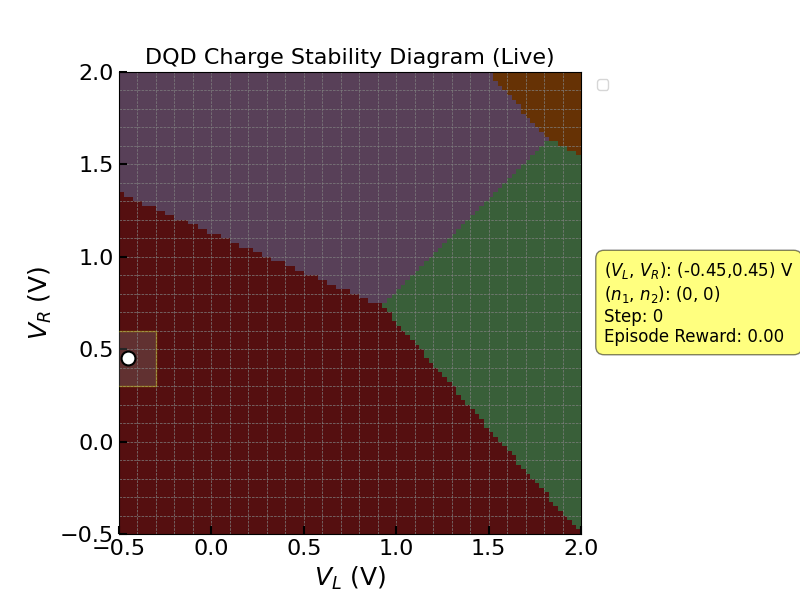

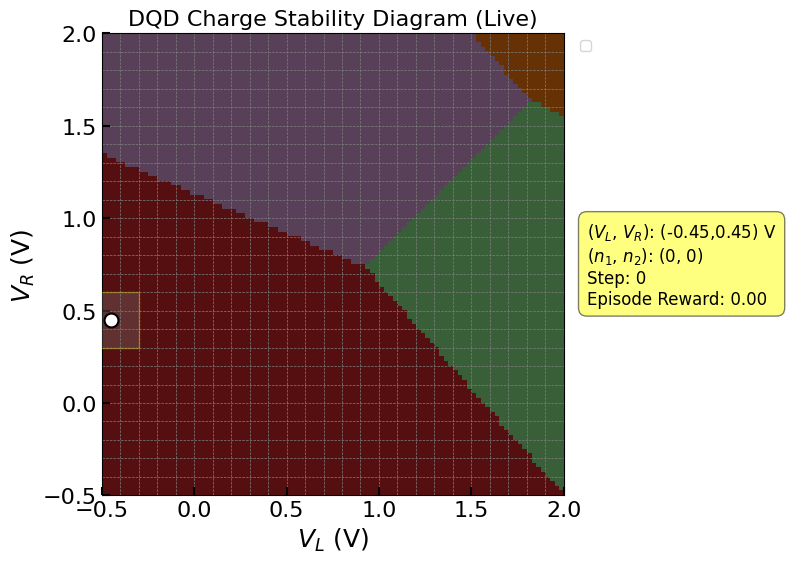

In [ ]:
obs, _ = env.reset(options={"get_CSD":True})
env.render()

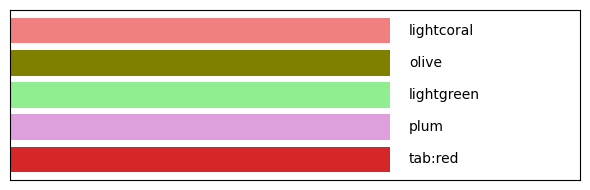

In [ ]:
colors = ['tab:red', 'plum', 'lightgreen', 'olive', 'lightcoral']

# Create a horizontal bar for each color
fig, ax = plt.subplots(figsize=(6, 2))
for i, color in enumerate(colors):
    ax.barh(i, 1, color=color)
    ax.text(1.05, i, color, va='center')

ax.set_yticks([])
ax.set_xticks([])
ax.set_xlim(0, 1.5)
plt.tight_layout()
plt.show()

In [ ]:
x = 0
y = 80
cell_value = env.high_res_charge_config_grid[y, x]
print(f"Cell at ({x},{y}): value={cell_value}, config={env.id_to_config_map[cell_value]}, color={env.color_map.get(env.id_to_config_map[cell_value])}")

Cell at (0,80): value=1, config=(np.int64(0), np.int64(1)), color=plum


In [ ]:
for i, config_tuple in enumerate(env.id_to_config_map):

    # Use the config tuple to look up the color in the color_map dictionary
    # Using .get() is safer in case a key is missing
    color = env.color_map.get(config_tuple, "Color Not Found")

    print(f"ID {i}: config {config_tuple} → color {color}")

ID 0: config (np.int64(0), np.int64(0)) → color tab:red
ID 1: config (np.int64(0), np.int64(1)) → color plum
ID 2: config (np.int64(1), np.int64(0)) → color lightgreen


In [ ]:
co

In [ ]:
env.high_res_charge_config_grid

array([[0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       ...,
       [1, 1, 1, ..., 2, 2, 2],
       [1, 1, 1, ..., 2, 2, 2],
       [1, 1, 1, ..., 2, 2, 2]])

/tmp/ipython-input-212-1657715129.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))


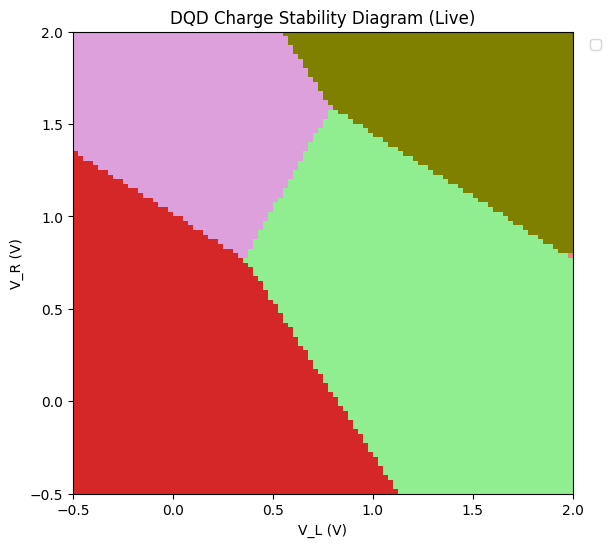

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
fig.subplots_adjust(right=0.75)
ax.set_xlim(env.min_gate_voltage, env.max_gate_voltage)
ax.set_ylim(env.min_gate_voltage, env.max_gate_voltage)
ax.set_xlabel("V_L (V)")
ax.set_ylabel("V_R (V)")
ax.set_title("DQD Charge Stability Diagram (Live)")
ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))
background_image = ax.imshow(
                    env.high_res_charge_config_grid,
                    extent=env.CSD_extent,
                    origin='lower',
                    cmap=env.CSD_colormap,
                    aspect='auto',
                    zorder=-2
                )

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
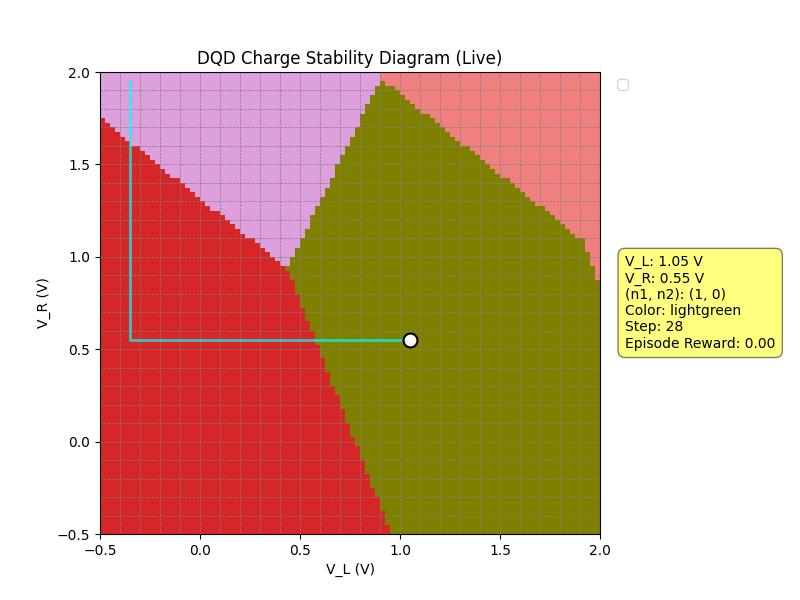

In [ ]:
for j in range(1,15):
    env.step(1)
env.render()

In [ ]:
background_image = ax.imshow(
                    env.high_res_charge_config_grid,
                    extent=env.CSD_extent,
                    origin='lower',
                    cmap=env.CSD_colormap,
                    aspect='auto',
                    zorder=-2
                )
env.background_image = background_image
env.ground_image.set_data(env.high_res_charge_config_grid)
env.render()

TypeError: DQDConstantInteractionEnv_v5._maybe_load_CSD_and_colormap() missing 2 required positional arguments: 'group' and 'options'

In [ ]:
from IPython.display import display
display(env._draw_background())

None

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
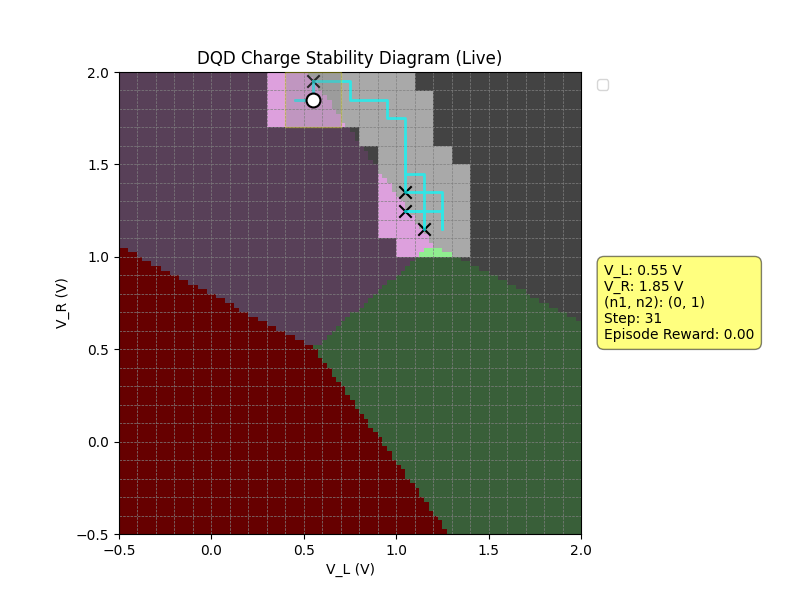

In [ ]:
for j in range(1,20):
    action = env.action_space.sample()
    obs, reward, terminated, truncated, info = env.step(action)

env.render()



In [ ]:
env2 = DQDConstantInteractionEnv_v5(render_mode="rgb_array")

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.


[(np.int64(0), np.int64(0)), (np.int64(0), np.int64(1)), (np.int64(1), np.int64(0)), (np.int64(1), np.int64(1))]
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...
DEBUG: Colormap colors: ['red', 'plum', 'lightgreen', 'black']


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
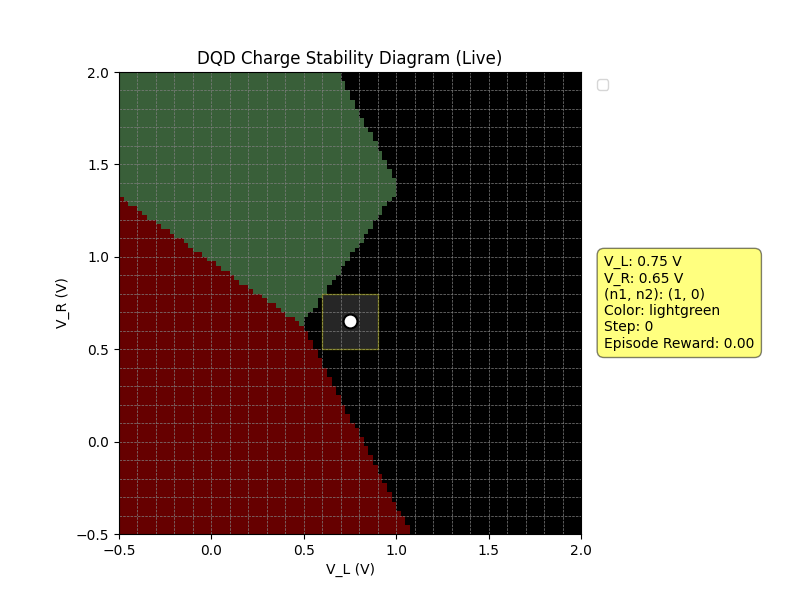

In [ ]:
env2.reset(options={"get_CSD":True})
env2.render()

In [ ]:
env2.high_res_charge_config_grid

array([[0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       ...,
       [1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3]])

In [ ]:
env2.color_map.get((0, 1), 'Unknown')

'plum'

In [ ]:
env2.id_to_config_map

[(np.int64(0), np.int64(0)),
 (np.int64(0), np.int64(1)),
 (np.int64(1), np.int64(0)),
 (np.int64(1), np.int64(1))]

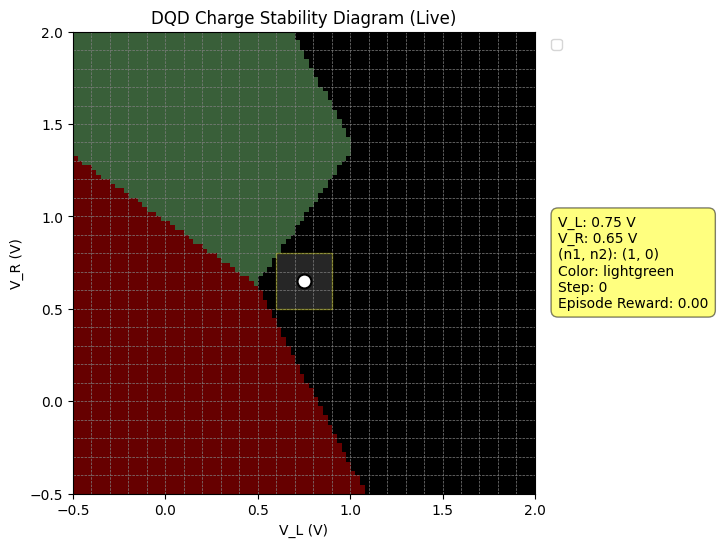

In [ ]:
env2._init_figure_if_needed()
env2._draw_background()
display(env2.fig)

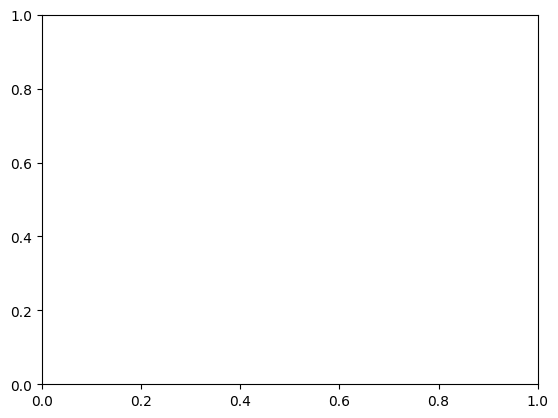

In [ ]:
fig, ax = plt.subplots()
img = env2.background_image
plt.show()

In [ ]:
data[1]

array([[255, 255, 255],
       [255, 255, 255],
       [255, 255, 255],
       ...,
       [255, 255, 255],
       [255, 255, 255],
       [255, 255, 255]], dtype=uint8)

/tmp/ipython-input-76-1657715129.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))


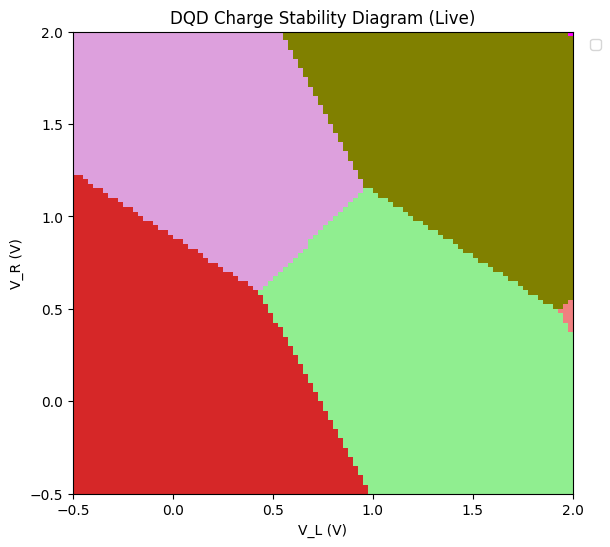

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
fig.subplots_adjust(right=0.75)
ax.set_xlim(env.min_gate_voltage, env.max_gate_voltage)
ax.set_ylim(env.min_gate_voltage, env.max_gate_voltage)
ax.set_xlabel("V_L (V)")
ax.set_ylabel("V_R (V)")
ax.set_title("DQD Charge Stability Diagram (Live)")
ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))
background_image = ax.imshow(
                    env.high_res_charge_config_grid,
                    extent=env.CSD_extent,
                    origin='lower',
                    cmap=env.CSD_colormap,
                    aspect='auto',
                    zorder=-2
                )

In [ ]:
n1, n2 = env2.current_charge_config

In [ ]:
env2.color_map.get((0, 1), 'Unknown')

'plum'

In [ ]:
env2.current_charge_config

(np.int64(1), np.int64(0))

In [ ]:
env2.low_res_charge_config_grid[env2.current_V_R_idx, env2.current_V_L_idx]

np.int64(1)

In [ ]:
env2.high_res_charge_config_grid

array([[0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       [0, 0, 0, ..., 2, 2, 2],
       ...,
       [1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3],
       [1, 1, 1, ..., 3, 3, 3]])

In [ ]:
env2.id_to_config_map

[(np.int64(0), np.int64(0)),
 (np.int64(0), np.int64(1)),
 (np.int64(1), np.int64(0)),
 (np.int64(1), np.int64(1))]

In [ ]:
charge_id = env2.low_res_charge_config_grid[env2.current_V_L_idx, env2.current_V_R_idx]
env2.current_charge_config = env2.id_to_config_map[charge_id]

NameError: name 'self' is not defined

In [ ]:
env2.low_res_charge_config_grid[21,14]

np.int64(1)

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
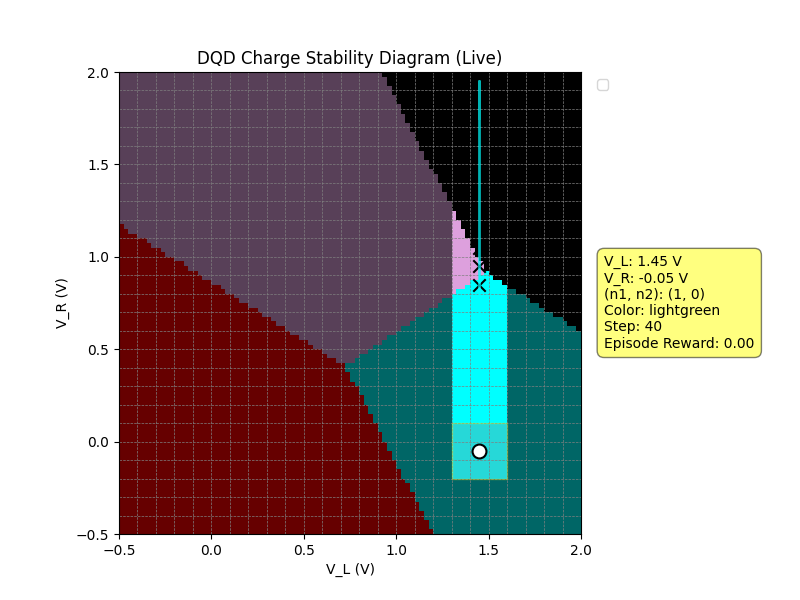

In [ ]:
for j in range(1,11):
    env2.step(2)
env2.render()

In [ ]:
for config_tuple_np in env2.id_to_config_map:
    config_tuple_py = (int(config_tuple_np[0]), int(config_tuple_np[1]))
    color = env2.color_map.get(config_tuple_py, 'white')
    print(f"{config_tuple_np}, {color}")


(np.int64(0), np.int64(0)), red
(np.int64(0), np.int64(1)), plum
(np.int64(1), np.int64(1)), black
(np.int64(1), np.int64(0)), lightgreen
(np.int64(2), np.int64(0)), blue
(np.int64(2), np.int64(1)), magenta


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [ ]:
env2.color_map

{(0, 0): 'red',
 (1, 0): 'lightgreen',
 (0, 1): 'plum',
 (1, 1): 'black',
 (2, 0): 'blue',
 (0, 2): 'cyan',
 (2, 1): 'magenta',
 (1, 2): 'brown',
 (2, 2): 'gray',
 (3, 0): 'tgreen',
 (0, 3): 'purple',
 (3, 1): 'darkgreen',
 (1, 3): 'indigo',
 (3, 2): 'darkorange',
 (2, 3): 'darkcyan',
 (3, 3): 'blue'}

In [ ]:
class RandomPolicy:
    def __init__(self, action_space: gym.spaces.Discrete):
        if not isinstance(action_space, gym.spaces.Discrete):
            raise TypeError("This policy only supports Discrete action spaces.")
        self.action_space = action_space

    def __call__(self, observation):
        return self.action_space.sample()

## 3. Actor-Critic Recurrent Net
`ActorCriticRecurrent(bservation_space: gym.spaces.Dict, action_dim: int, discrete_action: bool = False,lstm_size: int = 256)`

- `forward(obs, lstm_state)`: dist, value, new_lstm_state
- `get_action_and_value(obslstm_state)`: actions, log_probs, entropies, value, new_lstm_state

In [ ]:
# @title
class ActorCriticRecurrent(nn.Module):
    def __init__(self, observation_space: gym.spaces.Dict, action_dim: int,
                 discrete_action: bool = False,
                 lstm_size: int = 256,
                 custom_lstm_init: bool = False,
                 lstm_init_std: float = 1.0):
        super().__init__()

        self.lstm_size = lstm_size
        self.action_dim = action_dim
        self.discrete_action = discrete_action
        self.lstm_init_std = lstm_init_std



        # --- Vision Stream (CNN) ---
        self.vision_shape = observation_space["vision"].shape
        in_channels = 1
        self.cnn_extractor = nn.Sequential(
            # For a 3x3 patch, a kernel of size 2 is a good choice
            nn.Conv2d(in_channels, 16, kernel_size=2, stride=1),
            nn.SiLU(),
            nn.Flatten(),
        )

        with torch.no_grad():
            cnn_output_dim = self.cnn_extractor(torch.zeros(1, 1, *self.vision_shape)).shape[1]

        # --- Coordinates Stream ---
        coords_dim = observation_space["coords"].shape[0]

        # --- Recurrent Core (LSTM) ---
        # The LSTM takes the combined features as input
        combined_features_dim = cnn_output_dim + coords_dim
        self.lstm = nn.LSTM(combined_features_dim, self.lstm_size, batch_first=True)

        if custom_lstm_init:
            self.apply(self._init_weights)
            print(f"\n--- Custom LSTM initialization applied with std={self.lstm_init_std} ---")

        self.layer_norm = nn.LayerNorm(self.lstm_size)


        # --- Actor and Critic Heads ---
        # These now take the output of the LSTM as input
        self.actor_head = nn.Linear(self.lstm_size, action_dim)
        self.critic_head = nn.Linear(self.lstm_size, 1)

        print(f"\n--- ActorCriticVision Initialization ---")
        print(f"  CNN Output Dim: {cnn_output_dim}")
        print(f"  Coords Dim: {coords_dim}")
        print(f"  Combined Features Dim: {combined_features_dim}")

    def _init_weights(self, m: nn.Module):
        """Applies custom weight initialization to LSTM layers."""
        if isinstance(m, nn.LSTM):
            for name, param in m.named_parameters():
                if 'bias' in name:
                    nn.init.constant_(param, 0)
                elif 'weight' in name:
                    # Use the std passed during initialization
                    nn.init.normal_(param, mean=0, std=self.lstm_init_std)

    def forward(self, obs_seq: dict, initial_lstm_state: tuple[torch.Tensor, torch.Tensor]):
        # For training.
        batch_size = obs_seq['coords'].shape[0]
        seq_len = obs_seq['coords'].shape[1]

        vision_obs = obs_seq["vision"]
        vision_flat = vision_obs.view(batch_size * seq_len, 1, *self.vision_shape)
        vision_features_flat = self.cnn_extractor(vision_flat)

        coords_obs = obs_seq["coords"]
        coords_flat = coords_obs.view(batch_size * seq_len, -1)



        combined_features_flat = torch.cat([vision_features_flat, coords_flat], dim=1)

        lstm_input = combined_features_flat.view(batch_size, seq_len, -1)

        lstm_output, new_lstm_state = self.lstm(lstm_input, initial_lstm_state)

        normalized_features = self.layer_norm(lstm_output)
        logits = self.actor_head(normalized_features)
        value = self.critic_head(normalized_features).squeeze(-1)
        dist = torch.distributions.Categorical(logits=logits)

        # if self.discrete_action:
        #     logits = self.actor_out(actor_features)
        #     dist = Categorical(logits=logits)
        # else:
        #     mean = self.actor_mean(actor_features)
        #     std = torch.exp(self.log_std)
        #     dist = torch.distributions.Normal(mean, std)

        return dist, value, new_lstm_state


    def get_action_and_value(self, obs: dict, lstm_state):
        # For interaction.
        seq_obs = {key: val.unsqueeze(1) for key, val in obs.items()}

        dist, value, new_lstm_state = self.forward(seq_obs, lstm_state)
        actions = dist.sample()

        log_probs = dist.log_prob(actions)
        entropies = dist.entropy()

        # if self.discrete_action:
        #     log_probs = dist.log_prob(actions)
        #     entropies = dist.entropy()
        # else:
        #     log_probs = dist.log_prob(actions).sum(dim=-1)
        #     entropies = dist.entropy().sum(dim=-1)

        return actions.squeeze(1), value.squeeze(1), log_probs.squeeze(1), entropies.squeeze(1), new_lstm_state

## 4. RolloutBuffer
`RolloutBuffer(self, n_steps, num_envs, observation_space: gym.spaces.Dict, action_space: gym.spaces.Space, lstm_size: int, device="cpu")`

In [ ]:
# @title
class RolloutBuffer:
    def __init__(self, n_steps, num_envs, observation_space: gym.spaces.Dict,
                 action_space: gym.spaces.Space, lstm_size: int, device="cpu"):
        self.n_steps = n_steps
        self.num_envs = num_envs
        self.lstm_size = lstm_size
        self.device = device

        # --- Observation Buffers ---
        self.obs_bufs = {}
        for key, space in observation_space.spaces.items():
            self.obs_bufs[key] = torch.zeros((self.n_steps, self.num_envs, *space.shape),
                                             dtype=torch.float32, device=self.device)

        # --- Action Buffer ---
        if isinstance(action_space, gym.spaces.Discrete):
            self.action_buf = torch.zeros((self.n_steps, self.num_envs), dtype=torch.int64,
                                          device=self.device)
        else:
            self.action_buf = torch.zeros((self.n_steps, self.num_envs, *action_space.shape),
                                          dtype=torch.float32, device=self.device)

        # --- Standard PPO Buffers ---
        self.reward_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)
        self.done_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)
        self.log_prob_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)
        self.value_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)
        self.advantages_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)
        self.returns_buf = torch.zeros((self.n_steps, self.num_envs), device=self.device)

        # --- ADDED: Buffers for LSTM Hidden States ---
        self.h_state_buf = torch.zeros((self.n_steps, self.num_envs, self.lstm_size), device=self.device)
        self.c_state_buf = torch.zeros((self.n_steps, self.num_envs, self.lstm_size), device=self.device)

        self._ptr = 0
        self.is_full = False

    def store(self, obs: dict, action, reward, done, log_prob, value,
              lstm_state: tuple[torch.Tensor, torch.Tensor]):
        if self.is_full:
            raise BufferError("Buffer is full.")

        for key, obs_value in obs.items():
            self.obs_bufs[key][self._ptr] = torch.as_tensor(obs_value, device=self.device)

        self.action_buf[self._ptr] = action
        self.reward_buf[self._ptr] = torch.as_tensor(reward).to(self.device)
        self.done_buf[self._ptr] = torch.as_tensor(done).to(self.device)
        self.log_prob_buf[self._ptr] = log_prob
        self.value_buf[self._ptr] = value

        # Store the LSTM states
        self.h_state_buf[self._ptr] = lstm_state[0].squeeze(0)
        self.c_state_buf[self._ptr] = lstm_state[1].squeeze(0)

        self._ptr += 1
        if self._ptr == self.n_steps:
            self.is_full = True

    def _calculate_gae_single_trajectory(self, last_value, last_done, gamma, gae_lambda):
        if not self.is_full:
             raise BufferError("Buffer is not full. Cannot compute GAE.")

        last_value = torch.as_tensor(last_value, device=self.device).flatten()
        last_done = torch.as_tensor(last_done, device=self.device).flatten()
        last_gae_lam = 0

        gae_advantages = []
        returns = []
        gae = 0.0

        for step in reversed(range(self.n_steps)):
            if step == self.n_steps - 1:
                next_non_terminal = 1.0 - last_done
                next_values = last_value
            else:
                next_non_terminal = 1.0 - self.done_buf[step + 1]
                next_values = self.value_buf[step + 1]

            delta = self.reward_buf[step] + gamma * next_values * next_non_terminal - self.value_buf[step]
            last_gae_lam = delta + gamma * gae_lambda * next_non_terminal * last_gae_lam
            self.advantages_buf[step] = last_gae_lam

        self.returns_buf = self.advantages_buf + self.value_buf

    # def get_sequences(self, sequence_length, shuffle=True):
    #     if not self.is_full:
    #         raise BufferError("Buffer is not full. Cannot generate batches.")

    #     indices = list(range(self.num_envs))

    #     if shuffle:
    #         random.shuffle(indices)

    #     for i in indices:
    #         start_idx = 0
    #         while start_idx < self.n_steps:
    #             end_idx = min(start_idx + sequence_length, self.n_steps)

    #             # Yield a dictionary for the observation sequence
    #             obs_seq = {key: buf[start_idx:end_idx, i] for key, buf in self.obs_bufs.items()}

    #             yield (
    #                 obs_seq,
    #                 self.action_buf[start_idx:end_idx, i],
    #                 self.log_prob_buf[start_idx:end_idx, i],
    #                 self.advantages_buf[start_idx:end_idx, i],
    #                 self.returns_buf[start_idx:end_idx, i],
    #                 self.value_buf[start_idx:end_idx, i],
    #                 (self.h_state_buf[start_idx, i].unsqueeze(0).unsqueeze(1),
    #                     self.c_state_buf[start_idx, i].unsqueeze(0).unsqueeze(1))
    #             )
    #             start_idx = end_idx

    #     self._ptr = 0
    #     self.is_full = False

    def get_batch_sequences(self, batch_size, sequence_length, shuffle=True):
        """
        Yields mini-batches of sequences from the buffer.

        :param batch_size: The number of sequences in each mini-batch.
        :param sequence_length: The length of each sequence.
        :param shuffle: Whether to shuffle the sequences before batching.
        """


        # Create all possible sequence start points
        # A sequence is identified by its environment index and its start step
        n_seq_per_env = self.n_steps // sequence_length
        if n_seq_per_env == 0:
            raise ValueError(f"n_steps ({self.n_steps}) must be >= sequence_length ({sequence_length})")

        all_indices = []
        for env_idx in range(self.num_envs):
            for start_step in range(0, n_seq_per_env * sequence_length, sequence_length):
                all_indices.append((env_idx, start_step))

        if shuffle:
            random.shuffle(all_indices)

        # Yield mini-batches
        for i in range(0, len(all_indices), batch_size):
            batch_indices = all_indices[i : i + batch_size]

            # --- Initialize lists to hold data for the current batch ---
            obs_batch = {key: [] for key in self.obs_bufs}
            action_batch, log_prob_batch = [], []
            advantages_batch, returns_batch, value_batch = [], [], []
            h_state_batch, c_state_batch = [], []

            for env_idx, start_step in batch_indices:
                end_step = start_step + sequence_length

                # --- Gather data for one sequence ---
                for key, buf in self.obs_bufs.items():
                    obs_batch[key].append(buf[start_step:end_step, env_idx])

                action_batch.append(self.action_buf[start_step:end_step, env_idx])
                log_prob_batch.append(self.log_prob_buf[start_step:end_step, env_idx])
                advantages_batch.append(self.advantages_buf[start_step:end_step, env_idx])
                returns_batch.append(self.returns_buf[start_step:end_step, env_idx])
                value_batch.append(self.value_buf[start_step:end_step, env_idx])

                # The initial hidden state is the one from the start of the sequence
                h_state_batch.append(self.h_state_buf[start_step, env_idx])
                c_state_batch.append(self.c_state_buf[start_step, env_idx])

            # --- Stack lists into tensors with a batch dimension ---
            # Shape for most tensors: (batch_size, sequence_length, ...)
            # Shape for initial hidden states: (1, batch_size, lstm_size)
            batch = {
                'obs': {key: torch.stack(val) for key, val in obs_batch.items()},
                'actions': torch.stack(action_batch),
                'log_probs': torch.stack(log_prob_batch),
                'advantages': torch.stack(advantages_batch),
                'returns': torch.stack(returns_batch),
                'values': torch.stack(value_batch),
                'initial_lstm_states': (
                    torch.stack(h_state_batch).unsqueeze(0),
                    torch.stack(c_state_batch).unsqueeze(0)
                )
            }
            yield batch

        # Reset the buffer after the generator is exhausted
        self._ptr = 0
        self.is_full = False


## 5. PPO Agent


```
PPOAgent(self, envs, actor_critic_net, max_grad_norm, env_id: str=None, gamma: float=0.99, entropy_beta: float=0.01, lr: float = 1e-4, gae_lambda: float = 0.95, clip_coef: float = 0.2,  n_steps: int=5, batch_size: int=64, num_epochs: int = 10, device="cpu", seed=0):
```



In [ ]:
# @title
from datetime import datetime
import pytz
import time
from collections import deque

class PPOAgent():
    def __init__(self, envs, actor_critic_net, max_grad_norm, env_id: str=None,
                 gamma: float=0.99, entropy_beta: float=0.01, lr: float = 1e-4,
                 gae_lambda: float = 0.95, clip_coef: float = 0.2, critic_coef:float=0.5,
                 n_steps: int=5, batch_size: int=64, num_epochs: int = 10,seq_len:int = 64,
                 device="cpu", seed=0):

        self.device = device
        self.seed = seed
        self.best_eval_score = -np.inf

        # --- Hyperparameters ---
        self.actor_critic_net = actor_critic_net.to(self.device)
        self.lstm_size = self.actor_critic_net.lstm_size
        self.optimizer = torch.optim.Adam(self.actor_critic_net.parameters(), lr=lr)
        self.max_grad_norm = max_grad_norm

        self.gamma = gamma
        self.gae_lambda = gae_lambda
        self.entropy_beta = entropy_beta
        self.clip_coef = clip_coef
        self.critic_coef = critic_coef
        self.batch_size = batch_size
        self.seq_len = seq_len
        self.num_epochs = num_epochs
        self.lr = lr
        self.n_steps = n_steps
        self.num_envs = envs.num_envs



        self.envs = envs
        if env_id is None:
            self.env_spec_id = getattr(envs, "spec", None).id if getattr(envs, "spec", None) else "UnknownEnv"
        else:
            self.env_spec_id = env_id
        self.env_class = self.envs.envs[0].env.__class__

        if hasattr(self.envs, 'single_observation_space'):
            print("DEBUG: Detected Gymnasium-style VecEnv.")

            self.is_discrete = isinstance(self.envs.single_action_space, gym.spaces.Discrete)
            # if self.is_discrete:
            #     self.action_dim = self.envs.action_space.n
            # else:
            #     self.action_dim = self.envs.single_action_space.shape[0]
        else:
            print("DEBUG: Detected Stable-Baselines-style VecEnv.")

            self.is_discrete = isinstance(self.envs.action_space, gym.spaces.Discrete)
            # if self.is_discrete:
            #     self.action_dim = self.envs.action_space.n
            # else:
            #     self.action_dim = self.envs.action_space.shape[0]

        print(f"Is the action space discrete? {self.is_discrete}")



        self.buffer = RolloutBuffer(n_steps=self.n_steps, num_envs=self.num_envs,
                                     observation_space=self.envs.observation_space,
                                    action_space=self.envs.action_space, device=self.device,
                                    lstm_size=self.lstm_size)

        # Episode tracker
        self.total_rollouts_finished = 0
        self.training_complete = False
        self.episode_rewards_deque = deque(maxlen=100)
        self.episode_lengths_deque = deque(maxlen=100)
        self.current_episode_lengths = torch.zeros(self.num_envs, dtype=torch.int32, device=self.device)
        self.global_steps = 0
        self.current_episode_rewards = torch.zeros(self.num_envs, device=self.device)


        # --- TensorBoard Setup ---
        tokyo = pytz.timezone('Asia/Tokyo')
        timestamp = datetime.now(tokyo).strftime('%Y%m%d-%H%M')
        log_dir = os.path.join(DIR, f"{timestamp}_{self.env_spec_id}_PPO")
        os.makedirs(log_dir, exist_ok=True)
        self.writer = SummaryWriter(log_dir)
        self.log_dir = log_dir
        print(f"TensorBoard logs being written to: {log_dir}")

    def train(self, max_minutes, goal_mean_100_reward, num_rollout=1000, save_every_rollouts=100,
                print_interval=10):
        # For Stable3 VecEnv.
        obs = self.envs.reset()
        obs_tensor = {
                    key: torch.as_tensor(val, dtype=torch.float32, device=self.device)
                    for key, val in obs.items()
                }

        lstm_state = (
            torch.zeros(1, self.num_envs, self.lstm_size, device=self.device),
            torch.zeros(1, self.num_envs, self.lstm_size, device=self.device)
        )

        scores = []

        start_time = time.time()
        last_eval_step = 0
        last_save_step = 0

        while self.total_rollouts_finished < num_rollout:
            step_count = 0
            for step_idx in range(self.n_steps):
                self.global_steps += self.num_envs

                lstm_state_to_store = (lstm_state[0].detach(),
                                       lstm_state[1].detach())

                with torch.no_grad():
                    actions, log_probs, _, values, new_lstm_state = self.actor_critic_net.get_action_and_value(obs_tensor, lstm_state)

                lstm_state = new_lstm_state

                actions_np = actions.cpu().numpy()

                next_obs, rewards, dones, infos = self.envs.step(actions_np)

                self.current_episode_lengths += 1

                self.buffer.store(obs, actions, rewards, dones, log_probs, values, lstm_state_to_store)

                obs = next_obs
                obs_tensor = {
                    key: torch.as_tensor(val, dtype=torch.float32, device=self.device)
                    for key, val in next_obs.items()
                }

                step_count += 1
                #if step_count % 200 == 0: # Print a message every 200 steps
                #    print(f"  ... still running step {step_count}, episode={self.total_episodes_finished}")

                self.current_episode_rewards += torch.tensor(rewards, device=self.device)

                if dones.any():
                    done_mask = torch.tensor(dones, dtype=torch.float32,
                                             device=self.device).view(1, self.num_envs, 1)
                    lstm_state = (
                        lstm_state[0] * (1 - done_mask),
                        lstm_state[1] * (1 - done_mask)
                    )
                    for i, done in enumerate(dones):
                        if done:
                            ep_reward = self.current_episode_rewards[i].item()
                            self.episode_rewards_deque.append(ep_reward)
                            self.current_episode_rewards[i] = 0.0
                            ep_length = self.current_episode_lengths[i].item()
                            self.episode_lengths_deque.append(ep_length)
                            self.current_episode_lengths[i] = 0

            self.total_rollouts_finished += 1

            if self.total_rollouts_finished % print_interval == 0:
                avg = np.mean(self.episode_rewards_deque)
                std = np.std(self.episode_rewards_deque)
                print(f"Rollout: {self.total_rollouts_finished}, Global Steps: {self.global_steps}, Avg Reward: {avg:.2f}, Std: {std:.2f}")
                self.writer.add_scalar("Training/Average Reward", avg, self.global_steps)
                self.writer.add_scalar("Training/Reward Std", std, self.global_steps)
                eval_score, eval_std = self.evaluate(n_episode=5)
                self.writer.add_scalar("Evaluation/Average Reward", eval_score, self.global_steps)
                self.writer.add_scalar("Evaluation/Std", eval_std, self.global_steps)

                avg_len = np.mean(self.episode_lengths_deque)
                std_len = np.std(self.episode_lengths_deque)
                print(f"Avg Episode Length: {avg_len:.2f}, Std: {std_len:.2f}")
                self.writer.add_scalar("Trainging/Episode Length_Average", avg_len, self.global_steps)
                self.writer.add_scalar("Trainging/Episode Length_Std", std_len, self.global_steps)

                if eval_score > self.best_eval_score:
                    self.best_eval_score = eval_score
                    best_model_path = os.path.join(self.writer.log_dir, f"best_actor_step_{self.global_steps}.pth")
                    torch.save(self.actor_critic_net.state_dict(), best_model_path)
                    print(f"🎉 New best model saved with score: {eval_score:.2f}")

            if self.total_rollouts_finished % save_every_rollouts == 0:
                path = os.path.join(self.writer.log_dir, f"actor_{self.global_steps}.pth")
                torch.save(self.actor_critic_net.state_dict(), path)



            self.update(obs_tensor, dones, lstm_state)
            print("Degug: Update successed")
            #print("--- Running evaluation ---")
            #self.evaluate(n_episode=5)
            #print(f"---------------------------------------------------------")




            if len(self.episode_rewards_deque) >= 100:
                mean_100 = np.mean(list(self.episode_rewards_deque)[-100:])
                if mean_100 >= goal_mean_100_reward:
                    print(f"🎯 Goal achieved with mean reward of {mean_100:.2f} over last 100 episodes!")
                    break

            elapsed = time.time() - start_time
            if elapsed > max_minutes * 60:
                print("⏰ Time budget exceeded.")
                break


        final_score, std = self.evaluate(n_episode=10)
        # --- Also save the final model at the very end of training ---
        final_save_path = os.path.join(self.writer.log_dir, "actor_final.pth")
        print(f"\n--- Saving final model to {final_save_path} ---")
        torch.save(self.actor_critic_net.state_dict(), final_save_path)

        self.envs.close()
        self.writer.close()
        print(f"\n✅ Training complete. Final eval: {final_score:.2f} ± {std:.2f}")
        return final_score

    def update(self, last_obs, last_dones, last_lstm_state):
        # update the network with PPO eqution
        # 1. Calculate GAE
        with torch.no_grad():
            _, _, _, last_value, _ = self.actor_critic_net.get_action_and_value(last_obs, last_lstm_state)
            last_dones = torch.as_tensor(last_dones, dtype=torch.float32, device=self.device)

        self.buffer._calculate_gae_single_trajectory(last_value, last_dones, self.gamma, self.gae_lambda)
        self.buffer.advantages_buf = (
                                self.buffer.advantages_buf - self.buffer.advantages_buf.mean()
                            ) / (self.buffer.advantages_buf.std() + 1e-8)

        for epoch in range(self.num_epochs):
            for batch in self.buffer.get_batch_sequences(batch_size=32, sequence_length=64,shuffle=True):
                obs_batch = batch['obs']
                initial_lstm_states_batch = batch['initial_lstm_states']
                actions_batch = batch['actions']
                old_log_probs_batch = batch['log_probs']
                advantages_batch = batch['advantages']
                returns_batch = batch['returns']
                old_values_batch = batch['values']
                dist, new_values, _ = self.actor_critic_net.forward(obs_batch, initial_lstm_states_batch)

                if self.is_discrete:
                    new_log_probs = dist.log_prob(actions_batch)
                    entropy = dist.entropy()
                else:
                    new_log_probs = dist.log_prob(actions_batch).sum(dim=-1)
                    entropy = dist.entropy().sum(dim=-1)


                ratio = (new_log_probs - old_log_probs_batch).exp()
                surr1 = ratio * advantages_batch
                surr2 = torch.clamp(ratio, 1.0 - self.clip_coef, 1.0 + self.clip_coef) * advantages_batch
                actor_loss = -torch.min(surr1, surr2).mean()

                v_loss_unclipped = F.mse_loss(new_values, returns_batch)
                values_clipped = old_values_batch + torch.clamp(
                                    new_values - old_values_batch, -self.clip_coef, self.clip_coef
                                )
                v_loss_clipped = F.mse_loss(values_clipped, returns_batch)
                critic_loss = self.critic_coef * torch.max(v_loss_unclipped, v_loss_clipped)

                total_loss = actor_loss + critic_loss - self.entropy_beta * entropy.mean()

                self.optimizer.zero_grad()
                total_loss.backward()
                torch.nn.utils.clip_grad_norm_(self.actor_critic_net.parameters(), self.max_grad_norm)
                self.optimizer.step()

                self.writer.add_scalar("Loss/Actor", actor_loss.item(), self.global_steps)
                self.writer.add_scalar("Loss/Critic", critic_loss.item(), self.global_steps)
                self.writer.add_scalar("Loss/Total_loss", total_loss.item(), self.global_steps)
                self.writer.add_scalar("Charts/predicted_value_mean", new_values.mean().item(), self.global_steps)

    def evaluate(self, n_episode=5):

        eval_env = self.env_class()
        rs = []
        self.actor_critic_net.eval()
        steps_lis = []

        for i in range(n_episode):
            obs, _ = eval_env.reset()

            lstm_state = (
                torch.zeros(1, 1, self.lstm_size, device=self.device),
                torch.zeros(1, 1, self.lstm_size, device=self.device)
            )

            is_done = False
            episode_rs = 0
            step_count = 0
            #print(f"--- Starting Evaluation Episode {i+1} ---")

            while not is_done:
                with torch.no_grad():
                    obs_tensor = {
                        key: torch.as_tensor(val, dtype=torch.float32).unsqueeze(0).to(self.device)
                        for key, val in obs.items()
                    }
                    seq_obs = {key: val.unsqueeze(1) for key, val in obs_tensor.items()}

                    dist, _, new_lstm_state = self.actor_critic_net(seq_obs, lstm_state)
                    lstm_state = new_lstm_state

                    action = dist.probs.argmax(dim=-1)

                if self.is_discrete:
                    # For Discrete spaces, convert the tensor to a Python integer
                    action_np = action.item()
                else:
                    # For Continuous spaces, convert to a NumPy array
                    action_np = action.cpu().numpy().flatten()

                next_obs, reward, termin, trunc, _ = eval_env.step(action_np)
                is_done = termin or trunc
                episode_rs += reward
                obs = next_obs

                step_count += 1
                #if step_count % 200 == 0: # Print a message every 200 steps
                #    print(f"  ... still running step {step_count}, done={is_done}")

                # The max steps for LunarLander/Hopper is 1000.
                # If it goes way beyond this, something is wrong.
                if step_count > 1500:
                    print("!!! SAFETY BREAK: Episode is likely stuck in an infinite loop. !!!")
                    break

            #print(f"--- Finished Episode {i+1} in {step_count} steps. Reward: {episode_rs:.2f} ---")

            rs.append(episode_rs)
            steps_lis.append(step_count)
        print(f"--- Run Average {np.mean(steps_lis)} steps. Reward: {np.mean(rs):.2f} ± {np.std(rs):.2f} ---")
        self.actor_critic_net.train()
        return np.mean(rs), np.std(rs)

## Training LR= 2.5e-4

In [ ]:
# Hyperparameters
GAMMA = 0.999
GAE_LAMBDA = 0.98
ENTROPY_BETA = 0.1
MAX_MINUTES = 20
MAX_EPISODES = 2000
N_STEPS = 1024
GOAL_MEAN_100_REWARD = 250
PRINT_INTERVAL = 10
SAVE_EVERY_EPISODES = 100
TRAIN_EPOCHS = 10
TRAIN_BATCH_SIZE = 32
N_WORKERS = 16
CLIP_COEF = 0.1
CRITIC_COEF = 0.5
SEQ_LEN = 64

MAX_GRAD_NORM = 1.0 # Single grad norm for the combined network
DEBUG_MODE = True
LR = 2.5e-4

# Network architecture for the shared base and heads
SHARED_HIDDEN_DIMS = (256, 256)
LSTM_SIZE = 512
ACTOR_HEAD_DIMS = () # No additional layers after shared for actor
CRITIC_HEAD_DIMS = () # No additional layers after shared for critic
Initial_LSTM = False

In [ ]:
hyperparams = {
    "GAMMA": GAMMA,
    "GAE_LAMBDA": GAE_LAMBDA,
    "ENTROPY_BETA": ENTROPY_BETA,
    "MAX_MINUTES": MAX_MINUTES,
    "MAX_EPISODES": MAX_EPISODES,
    "N_STEPS": N_STEPS,
    "GOAL_MEAN_100_REWARD": GOAL_MEAN_100_REWARD,
    "PRINT_INTERVAL": PRINT_INTERVAL,
    "SAVE_EVERY_EPISODES": SAVE_EVERY_EPISODES,
    "TRAIN_EPOCHS": TRAIN_EPOCHS,
    "TRAIN_BATCH_SIZE": TRAIN_BATCH_SIZE,
    "N_WORKERS": N_WORKERS,
    "CLIP_COEF": CLIP_COEF,
    "CRITIC_COEF": CRITIC_COEF,
    "SEQ_LEN": SEQ_LEN,
    "MAX_GRAD_NORM": MAX_GRAD_NORM,
    "DEBUG_MODE": DEBUG_MODE,
    "LR": LR,
    "SHARED_HIDDEN_DIMS": list(SHARED_HIDDEN_DIMS),
    "LSTM_SIZE": LSTM_SIZE,
    "Initial_LSTM": Initial_LSTM,
    "ACTOR_HEAD_DIMS": list(ACTOR_HEAD_DIMS),
    "CRITIC_HEAD_DIMS": list(CRITIC_HEAD_DIMS)
}
hparam_md = "| Hyperparameter | Value |\n| :--- | :--- |\n"
for key, value in hyperparams.items():
    hparam_md += f"| {key} | {value} |\n"

In [ ]:
envs = make_vec_env(DQDConstantInteractionEnv_v5, n_envs=N_WORKERS)

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from

In [ ]:
net = ActorCriticRecurrent(observation_space=envs.observation_space, action_dim=envs.action_space.n, discrete_action=True,
                           lstm_size=LSTM_SIZE)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


In [ ]:
ppo_agent = PPOAgent(envs, trained_net_last_best, env_id="DoubleQD_v5", gamma=GAMMA, entropy_beta=ENTROPY_BETA,
                     lr=LR, gae_lambda=GAE_LAMBDA, clip_coef=CLIP_COEF, critic_coef=CRITIC_COEF,
                     n_steps=N_STEPS,batch_size=TRAIN_BATCH_SIZE, num_epochs=TRAIN_EPOCHS,
                     device=device, max_grad_norm=MAX_GRAD_NORM, seq_len=SEQ_LEN)

DEBUG: Detected Stable-Baselines-style VecEnv.
Is the action space discrete? True
TensorBoard logs being written to: /content/drive/My Drive/TensorBoard/20250716-1453_DoubleQD_v5_PPO


In [ ]:
ppo_agent.evaluate()

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 26.04 ± 6.18 ---


(np.float64(26.040688), np.float64(6.175638955374256))

In [ ]:
ppo_agent.writer.add_text("Hyperparameters", hparam_md)

In [ ]:
ppo_agent.current_episode_lengths.zero_()
ppo_agent.current_episode_rewards.zero_()
ppo_agent.envs = envs

In [ ]:
ppo_agent.train(max_minutes=90, goal_mean_100_reward=35, num_rollout=MAX_EPISODES,
                save_every_rollouts=2, print_interval=2)

Degug: Update successed
Rollout: 110, Global Steps: 1802240, Avg Reward: -2.54, Std: 14.94
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 24.85 ± 9.78 ---
Avg Episode Length: 1250.00, Std: 0.00
Degug: Update successed
Degug: Update successed
Rollout: 112, Global Steps: 1835008, Avg Reward: -3.30, Std: 16.14
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 20.08 ± 7.64 ---
Avg Episode Length: 1250.00, Std: 0.00
Degug: Update successed
Degug: Update successed
Rollout: 114, Global Steps: 1867776, Avg Reward: -2.54, Std: 16.86
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 31.31 ± 6.29 ---
Avg 

np.float64(34.258615999999996)

In [ ]:
ppo_agent.envs.close()

In [ ]:
# continue training if need.
ppo_agent.lr = 2.5e-4
ppo_agent.critic_coef = 0.5
ppo_agent.envs = envs

0.00025

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...


/tmp/ipython-input-8-914240813.py:273: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  self.ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))


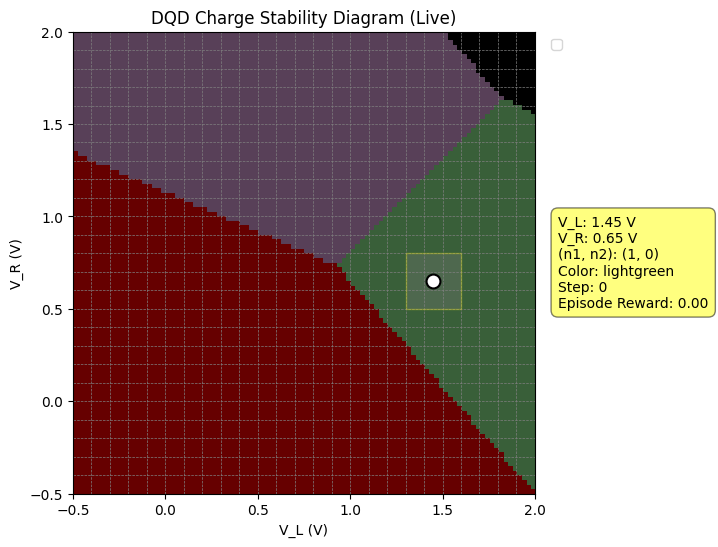

In [ ]:
test_env = DQDConstantInteractionEnv_v5(render_mode="rgb_array")
obs, _ = test_env.reset(options={"get_CSD":True})

In [ ]:
visualize_and_generate_video_PPO(trained_net=ppo_agent.actor_critic_net, env=test_env, max_steps=500,
                                 expoleration=None, video_filename="steps_1o7M.mp4")

--- Starting visualization ---
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...


--- Visualization complete. Total reward: 30.88 ---
--- Saving video to /content/drive/My Drive/Videos/20250716_PPO_LSTM/steps_1o7M_r_31.mp4 ---
--- Video saved successfully ---


In [ ]:
trained_net_last_best = ActorCriticRecurrent(observation_space=envs.observation_space, action_dim=envs.action_space.n, discrete_action=True,
                                             lstm_size=LSTM_SIZE)
model_path = os.path.join(DIR, "20250716-1453_DoubleQD_v5_PPO/best_actor_step_2555904.pth")
trained_net_last_best.load_state_dict(torch.load(model_path))
trained_net_last_best.to(device)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


ActorCriticRecurrent(
  (cnn_extractor): Sequential(
    (0): Conv2d(1, 16, kernel_size=(2, 2), stride=(1, 1))
    (1): SiLU()
    (2): Flatten(start_dim=1, end_dim=-1)
  )
  (lstm): LSTM(66, 512, batch_first=True)
  (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
  (actor_head): Linear(in_features=512, out_features=4, bias=True)
  (critic_head): Linear(in_features=512, out_features=1, bias=True)
)

In [ ]:
visualize_and_generate_video_PPO(trained_net=trained_net_last_best, env=test_env, max_steps=300,
                                 expoleration=None, video_filename="steps_2o5M.mp4")

--- Starting visualization ---
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...


--- Visualization complete. Total reward: 31.22 ---
--- Saving video to /content/drive/My Drive/Videos/20250716_PPO_LSTM/steps_2o5M_r_31.mp4 ---
--- Video saved successfully ---


In [ ]:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/My Drive/TensorBoard/"

<IPython.core.display.Javascript object>

In [ ]:
# @title
class DQDConstantInteractionEnv_v6(gym.Env):
    """
    A Double Quantum Dot (DQD) environment based on the constant interaction model.
    V5 Changes:
    - Load CSD cach. Reset will randomly sample from the cach.
    """

    metadata = {"render_modes": ["human", "rgb_array", "none"], "render_fps": 30}

    def __init__(self, render_mode=None, cache_path=CACHE_PATH):
        super().__init__()

        # ---Load Device Parameters (Capacitances) ---
        print(f"Loading pre-computed environment cache from {cache_path}...")
        if not os.path.exists(cache_path):
            raise FileNotFoundError(f"Cache file not found at {cache_path}. Please run the data generation cell first.")

        self.h5_file = h5py.File(cache_path, 'r')
        self.config_keys = list(self.h5_file.keys())
        print(f"✅ Ready to use {len(self.config_keys)} configurations from cache.")


        # --- Electron Charge ---
        self.e = 1.0

        self.Cmat_inv = None

        # --- Gate Voltage Range ---
        self.min_gate_voltage = -0.5
        self.max_gate_voltage = 2.0
        self.gate_voltage_step = 0.1

        # --- Gate Voltage Grid Definition  ---
        # Create the grid world N*N where N = (V_max - V_min) / V_step
        # The observed pos is coarsed-grained to the grid.
        # For example, if the agent is in  0.4<x<0.5, 0.2<y<0.3, then state=(0.45,0.25).
        self.first_grid_center = self.min_gate_voltage + self.gate_voltage_step / 2
        self.last_grid_center = self.max_gate_voltage - self.gate_voltage_step / 2
        self.grid_size = int(round((self.last_grid_center - self.first_grid_center) / self.gate_voltage_step)) + 1

        # Define the voltage centers
        self.V_L_centers = np.linspace(self.first_grid_center, self.last_grid_center, self.grid_size)
        self.V_R_centers = np.linspace(self.first_grid_center, self.last_grid_center, self.grid_size)

        # --- END Grid Definition Changes ---

        # Episode parameters
        self.max_steps = 2 * self.grid_size ** 2 # Max steps per episode
        self.step_count = 0

        # Current state variables (now integer indices into V_L_centers, V_R_centers)
        self.current_V_L_idx = 0
        self.current_V_R_idx = 0

        # The actual charge configuration is still determined by the continuous V_L, V_R values
        self.current_charge_config = (0, 0) # (n1, n2)

        # Reward parameters
        self.step_penalty = 0.0
        self.transition_reward = 1.0
        self.state_revisit_penalty = 0.0
        self.boundary_penalty_value = -1.0

        # Previous charge configurations for (potential future) tracking
        self.prev_charge_config = (0, 0)
        self.prev_prev_charge_config = (0, 0)

        self.visited_reward_grids = set()
        self.visited_states= set()


        self.action_space = gym.spaces.Discrete(4)

        # Observation Space: Vision + Coordinate
        # The 3x3 "vision" patch: 0 empty, 1 line, -1 wall.
        self.PATCH_SIZE = 3
        self.observation_space = gym.spaces.Dict({
            "vision": gym.spaces.Box(low=-1, high=1, shape=(self.PATCH_SIZE, self.PATCH_SIZE), dtype=np.int8),
            "coords": gym.spaces.Box(low=0.0, high=1.0, shape=(2,), dtype=np.float32)}
        )

        # Rendering setup
        self.render_mode = render_mode
        self.fig = None; self.ax = None; self.scatter = None; self.text = None
        self.CSD_grid = None
        self.CSD_colormap = None
        self.CSD_extent = None
        self.color_map = {
            (0,0): 'red', (1,0): 'lightgreen', (0,1): 'plum', (1,1): 'darkgray',
            (2,0): 'orange', (0,2): 'cyan', (2,1): 'magenta', (1,2): 'brown',
            (2,2): 'gray', (3,0): 'tgreen', (0,3): 'purple', (3,1): 'darkgreen',
            (1,3): 'indigo', (3,2): 'darkorange', (2,3): 'darkcyan', (3,3): 'blue'
        }
        self.background_image = None
        self.current_reward_for_render = 0.0
        self.visited_grids_scatter = None
        self.vision_image = None
        self.vision_patch_artist = None
        self.explored_map = np.zeros((self.grid_size, self.grid_size), dtype=bool)
        self.trajectory = []

    def _get_obs(self):
        pad_size = self.PATCH_SIZE // 2
        padded_grid = np.pad(self.current_reward_grid, pad_size, mode='constant', constant_values=-1)

        center_y = self.current_V_L_idx + pad_size
        center_x = self.current_V_R_idx + pad_size

        vision_patch_raw = padded_grid[
            center_y - pad_size : center_y + pad_size + 1,
            center_x - pad_size : center_x + pad_size + 1
        ]
        vision_patch_flipped = np.flipud(vision_patch_raw)
        vision_patch = vision_patch_flipped.copy()

        norm_v_l = self.current_V_L_idx / (self.grid_size - 1)
        norm_v_r = self.current_V_R_idx / (self.grid_size - 1)
        coords = np.array([norm_v_l, norm_v_r], dtype=np.float32)
        return {"vision": vision_patch, "coords": coords}


    def _get_continuous_voltage_from_idx(self, idx_L: int, idx_R: int) -> tuple[float, float]:
        """Converts integer grid indices to their corresponding continuous voltage center values."""
        v_l = self.V_L_centers[idx_L]
        v_r = self.V_R_centers[idx_R]
        return v_l, v_r



    def _reward(self) -> float:
        """
        Compute the reward to be given upon success
        """

        return 1 - 0.9 * (self.step_count / self.max_steps)


    def step(self, action: int):
        prev_charge_config = self.current_charge_config
        self.step_count += 1
        reward = 0
        terminated = False
        truncated = False

        new_V_L_idx = self.current_V_L_idx
        new_V_R_idx = self.current_V_R_idx

        # Determine intended next indices based on action
        # action=(0,1,2,3): (L-, L+, R-, R+)
        if action == 0:
            new_V_L_idx -= 1
        elif action == 1:
            new_V_L_idx += 1
        elif action == 2:
            new_V_R_idx -= 1
        elif action == 3:
            new_V_R_idx += 1
        else:
            raise ValueError(f"Invalid action: {action}. Expected action between 0 and 3.")

        #reward = self.step_penalty

        # HARD BOUNDARY CONSTRAINT: Check if intended move is out of bounds
        # Only update the position if the move is valid, i.e., in the grid world.
        if (0 <= new_V_L_idx < self.grid_size and 0 <= new_V_R_idx < self.grid_size):
            # Stop if hit a wall.
            self.current_V_L_idx = new_V_L_idx
            self.current_V_R_idx = new_V_R_idx
        else:
            reward = self.boundary_penalty_value


        # If move is valid, update current indices
        # note in python: A[y,x] gives the value at (x,y)
        charge_id = self.low_res_charge_config_grid[self.current_V_R_idx, self.current_V_L_idx]
        self.trajectory.append((self.current_V_L_idx, self.current_V_R_idx))

        self.current_charge_config = self.id_to_config_map[charge_id]
        l_idx, r_idx = self.current_V_L_idx, self.current_V_R_idx
        pad_size = self.PATCH_SIZE // 2
        l_start, l_end = np.clip([l_idx - pad_size, l_idx + pad_size + 1], 0, self.grid_size)
        r_start, r_end = np.clip([r_idx - pad_size, r_idx + pad_size + 1], 0, self.grid_size)
        self.explored_map[r_start:r_end, l_start:l_end] = True


        current_discrete_state_tuple = (self.current_V_L_idx, self.current_V_R_idx)
        self.visited_states.add(current_discrete_state_tuple)


        # Apply Reward (first time entering a block with a transition)
        if current_discrete_state_tuple in self.reward_grids_cache:
            if current_discrete_state_tuple not in self.visited_reward_grids:
                reward = self._reward()
                self.visited_reward_grids.add(current_discrete_state_tuple)
                r_idx, c_idx = current_discrete_state_tuple
                self.current_reward_grid[r_idx, c_idx] = 0

        if len(self.reward_grids_cache) > 0 and len(self.visited_reward_grids) == len(self.reward_grids_cache):
            print(f"🎉 Success! All transition lines found at step {self.step_count}")
            terminated = True
            reward = 100.0 * self._reward()

        # Update previous configurations
        self.prev_prev_charge_config = prev_charge_config
        self.prev_charge_config = self.current_charge_config

        # Check for episode truncation (max steps reached)
        if self.step_count >= self.max_steps:
            truncated = True

        observation = self._get_obs()
        info = self._get_info()

        #if self.render_mode == "rgb_array":
        #    self._render_frame()


        return observation, reward, terminated, truncated, info


    def _get_info(self) -> dict:
        """
        Returns supplementary information about the environment's current state.
        This can include details useful for debugging or analysis but not part of the
        primary observation.
        """
        # Get continuous voltages from current discrete indices
        current_V_L, current_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)

        info = {
            "current_V_L_idx": self.current_V_L_idx,
            "current_V_R_idx": self.current_V_R_idx,
            "current_charge_config": self.current_charge_config,
            "prev_charge_config": self.prev_charge_config,
            "prev_prev_charge_config": self.prev_prev_charge_config,
            "num_transition_line_grid_found_this_episode": len(self.visited_reward_grids),
            "num_unique_states_visited_this_episode": len(self.visited_states),
            "Transition_line_grid": (self.current_V_L_idx, self.current_V_R_idx) in self.reward_grids_cache
        }
        return info


    def render(self):
        """Renders the environment's current state."""
        if self.render_mode == "rgb_array":
            return self._render_frame()

        if self.render_mode == "human":
            self._render_frame()

    def _render_frame(self):
        """Internal rendering logic for human mode."""
        if self.render_mode == "none":
            return

        if not plt.isinteractive():
            plt.ion()

        if self.fig is None:
            self.fig, self.ax = plt.subplots(figsize=(8, 6))
            self.fig.subplots_adjust(right=0.75)

            self.ax.set_xlim(self.min_gate_voltage, self.max_gate_voltage)
            self.ax.set_ylim(self.min_gate_voltage, self.max_gate_voltage)
            self.ax.set_xlabel("V_L (V)"); self.ax.set_ylabel("V_R (V)")
            self.ax.set_title("DQD Charge Stability Diagram (Live)")

            patch_width_in_steps = 3
            patch_width = patch_width_in_steps * self.gate_voltage_step

            self.vision_patch_artist = patches.Rectangle(
                (0, 0),
                patch_width, patch_width,
                linewidth=1,
                edgecolor='yellow',
                facecolor='grey',
                alpha=0.3, # Semi-transparent
                zorder=3   # Just below the detected grids and agent
                )
            self.ax.add_patch(self.vision_patch_artist)

            # Grid lines.
            grid_line_positions = np.arange(self.min_gate_voltage,
                                            self.max_gate_voltage,
                                            self.gate_voltage_step)
            for pos in grid_line_positions:
                self.ax.axvline(pos, color='grey', linestyle='--', linewidth=0.5, zorder=0)
                self.ax.axhline(pos, color='grey', linestyle='--', linewidth=0.5, zorder=0)

            # Fog_of_War
            self.fog_of_war_artist = self.ax.imshow(
                    np.zeros((self.grid_size, self.grid_size, 4)), # Start with a transparent RGBA image
                    extent=self.CSD_extent,
                    origin='lower',
                    zorder=2,
                    interpolation='none' # Use 'none' for a crisp pixelated look
                )

            # Trajectory line artist
            self.traj_line, = self.ax.plot([], [], color='cyan', alpha=0.7, linewidth=2, label="Trajectory", zorder=3)

            # The current state scatter point will use the center voltages
            self.scatter = self.ax.scatter([], [], c='white',
                                           edgecolors='black', linewidth=1.5,
                                           marker='o', s=100,
                                           label="Current State", zorder=5, alpha=1)

            # Record visited trainstion lines.
            self.visited_grids_scatter = self.ax.scatter([], [],
                                                     c='black',          # A bright color
                                                     marker='x',        # A distinct marker
                                                     s=80,              # Size of the marker
                                                     label='Detected Grids',
                                                     zorder=4)

            self.text = self.ax.text(1.05, 0.5, '', transform=self.ax.transAxes,
                                      verticalalignment='center', bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5))
            self.ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))
            if self.render_mode == "human":
                plt.show(block=False)


        if self.visited_reward_grids:
            visited_coords = [self._get_continuous_voltage_from_idx(l, r) for l, r in self.visited_reward_grids]
            v_l_coords, v_r_coords = zip(*visited_coords)
            self.visited_grids_scatter.set_offsets(np.c_[v_l_coords, v_r_coords])



        # Update scatter plot position and color using current V_L, V_R from indices
        current_V_L, current_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)
        self.scatter.set_offsets(np.array([[current_V_L, current_V_R]]))

        bottom_left_x = current_V_L - 1.5 * self.gate_voltage_step
        bottom_left_y = current_V_R - 1.5 * self.gate_voltage_step
        self.vision_patch_artist.set_xy((bottom_left_x, bottom_left_y))
        n1, n2 = self.current_charge_config

        fog_image = np.zeros((self.grid_size, self.grid_size, 4), dtype=np.float32)
        fog_image[~np.transpose(self.explored_map)] = [0, 0, 0, 0.6]
        self.fog_of_war_artist.set_data(fog_image)

        if len(self.trajectory) > 1:

            l_coords_idx, r_coords_idx = zip(*self.trajectory)

            v_l_coords = self.V_L_centers[np.array(l_coords_idx)]
            v_r_coords = self.V_R_centers[np.array(r_coords_idx)]

            self.traj_line.set_data(v_l_coords, v_r_coords)


        self.text.set_text(
            f'V_L: {current_V_L:.2f} V\n'
            f'V_R: {current_V_R:.2f} V\n'
            f'(n1, n2): ({n1}, {n2})\n'
            f'Step: {self.step_count}\n'
            f'Episode Reward: {self.current_reward_for_render:.2f}'
        )

        if self.high_res_charge_config_grid is not None:
        # If the background image artist hasn't been created yet, create it
            if self.background_image is None:
                self.background_image = self.ax.imshow(
                    self.high_res_charge_config_grid,
                    extent=self.CSD_extent,
                    origin='lower',
                    cmap=self.CSD_colormap,
                    aspect='auto',
                    zorder=-2
                )
            # If it already exists, just update its data (for future use)
            else:
                self.background_image.set_data(self.high_res_charge_config_grid)
                self.background_image.set_cmap(self.CSD_colormap)



        if self.render_mode == "human":
            self.fig.canvas.draw_idle()
            self.fig.canvas.flush_events()
            plt.pause(1 / self.metadata["render_fps"])
        elif self.render_mode == "rgb_array":
            self.fig.canvas.draw()
            rgba_buffer = self.fig.canvas.buffer_rgba()
            rgb_array = np.array(rgba_buffer, copy=True)
            return rgb_array[:,:, :3]


    def reset(self, seed=None, options=None):
        """Resets the environment to an initial state for a new episode."""
        super().reset(seed=seed)

        random_key = self.np_random.choice(self.config_keys)
        group = self.h5_file[random_key]

        params = {key: val for key, val in group.attrs.items()}
        cmat_inv = group['Cmat_inv'][()] # [()] reads data into a NumPy array
        reward_grids_array = group['reward_grids_cache'][()]
        reward_grids_cache = set(map(tuple, reward_grids_array))

        self.low_res_charge_config_grid = group['low_res_charge_config_grid'][()]
        self.id_to_config_map = list(map(tuple, group['id_to_config_map'][()]))

        for key, value in params.items():
            setattr(self, key, value)

        self.Cmat_inv = cmat_inv
        self.reward_grids_cache = reward_grids_cache


        self.step_count = 0
        self.visited_reward_grids.clear()
        self.visited_states.clear()
        self.explored_map.fill(False)
        self.trajectory.clear()

        self.current_reward_for_render = 0.0
        self.current_reward_grid = np.zeros((self.grid_size, self.grid_size), dtype=np.uint8)

        if options and options.get("get_CSD", False):
            print("DEBUG: 'get_CSD' is True. Loading pre-computed diagram...")
            # Load the high-res grid for rendering
            self.high_res_charge_config_grid = group['high_res_charge_config_grid'][()]
            colormap_colors = []

            for config_tuple_np in self.id_to_config_map:
                # Convert the (np.int64, np.int64) tuple to a standard (int, int) tuple
                # to ensure the dictionary lookup is robust.
                config_tuple_py = (int(config_tuple_np[0]), int(config_tuple_np[1]))
                color = self.color_map.get(config_tuple_py, 'white') # Default to black if not found
                colormap_colors.append(color)


            self.debug_colormap_colors = colormap_colors

            #colormap_colors = [self.color_map.get(tuple(c), 'black') for c in self.id_to_config_map]
            self.CSD_colormap = plt.cm.colors.ListedColormap(colormap_colors)
            self.CSD_extent = [self.min_gate_voltage, self.max_gate_voltage, self.min_gate_voltage, self.max_gate_voltage]

        if options and options.get("verbose", False):
            print("\n--- Environment Reset with New Parameters ---")
            for key in self._default_params.keys():
                print(f"  {key}: {getattr(self, key):.4f}")

        # Set initial gate voltage indices (can be random or specified)
        if options and "start_V_L" in options and "start_V_R" in options:
            # Find the closest bin index for the given continuous start voltage
            start_V_L = np.clip(options["start_V_L"], self.min_gate_voltage, self.max_gate_voltage)
            start_V_R = np.clip(options["start_V_R"], self.min_gate_voltage, self.max_gate_voltage)
            self.current_V_L_idx = np.argmin(np.abs(self.V_L_centers - start_V_L))
            self.current_V_R_idx = np.argmin(np.abs(self.V_R_centers - start_V_R))
        else:
            self.current_V_L_idx = self.np_random.integers(0, self.grid_size)
            self.current_V_R_idx = self.np_random.integers(0, self.grid_size)

        # Get continuous voltages for initial charge config and observation
        charge_id = self.low_res_charge_config_grid[self.current_V_L_idx, self.current_V_R_idx]
        initial_V_L, initial_V_R = self._get_continuous_voltage_from_idx(self.current_V_L_idx, self.current_V_R_idx)
        self.current_charge_config = self.id_to_config_map[charge_id]



        # Add the initial state to the visited states set for penalty tracking
        self.visited_states.add((self.current_V_L_idx, self.current_V_R_idx))

        # Initialize previous configurations
        self.prev_charge_config = self.current_charge_config
        self.prev_prev_charge_config = self.current_charge_config

        self.trajectory.append((self.current_V_L_idx, self.current_V_R_idx))


        observation = self._get_obs()
        info = self._get_info()
        if self.render_mode == "rgb_array":
            self._render_frame()


        return observation, info

    def close(self):
        """Closes the rendering window."""
        self.vision_image = None
        self.h5_file.close()
        self.vision_patch_artist = None
        if self.fig is not None:
            plt.close(self.fig)
            if plt.isinteractive():
                plt.ioff()
            self.fig = None
            self.ax = None
            self.scatter = None
            self.text = None
            self.background_image = None
            self.visited_grids_scatter = None

In [ ]:
obs['vision'][2,1] = 1
lstm_size = 256
lstm_state = (
                torch.zeros(1, 1, lstm_size, device=device),
                torch.zeros(1, 1, lstm_size, device=device)
            )
obs_tensor = {
                    key: torch.as_tensor(val, dtype=torch.float32, device=device).unsqueeze(0)
                    for key, val in obs.items()
                }
seq_obs = {key: val.unsqueeze(1) for key, val in obs_tensor.items()}
dist, _, new_lstm_state = ppo_agent.actor_critic_net(seq_obs, lstm_state)
dist.probs

tensor([[[0.1977, 0.2520, 0.2047, 0.3456]]], grad_fn=<SoftmaxBackward0>)

In [ ]:
env = DQDConstantInteractionEnv_v5(render_mode='rgb_array')

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.


In [ ]:
obs, _ = env.reset(options={"get_CSD":True})
obs['vision'][2,1] = 2
print(obs)

DEBUG: 'get_CSD' is True. Loading pre-computed diagram...
{'vision': array([[0, 0, 0],
       [0, 0, 0],
       [0, 2, 0]], dtype=uint8), 'coords': array([0.7916667 , 0.41666666], dtype=float32)}


array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
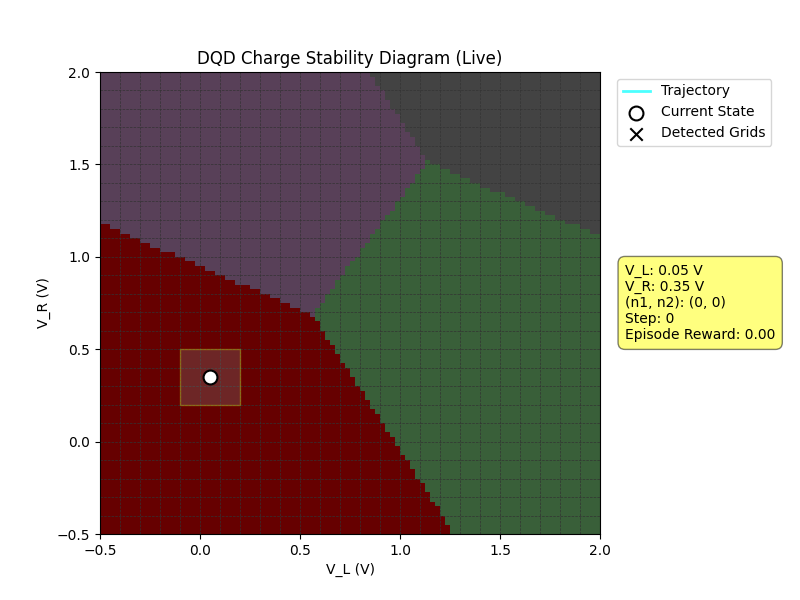

In [ ]:
env.render()

In [ ]:
seq_obs

{'vision': tensor([[[[0, 0, 0],
           [0, 0, 0],
           [0, 0, 0]]]], dtype=torch.int8),
 'coords': tensor([[[0.1250, 0.5833]]])}

In [ ]:
# 2. Get a sample observation from your environment
obs, info = env.reset()
# --- Get Action Probabilities ---
with torch.no_grad():
    # 3. Convert the observation to the correct tensor format
    # This mimics the logic in your training loop for a single step
    obs_tensor = {
        key: torch.as_tensor(val).unsqueeze(0) # Add a batch dimension
        for key, val in obs.items()
    }

    # 4. Create a dummy LSTM state (it's not critical for a single-step check)
    lstm_state = (
        torch.zeros(1, 1, ppo_agent.actor_critic_net.lstm_size),
        torch.zeros(1, 1, ppo_agent.actor_critic_net.lstm_size)
    )

    obs_tensor = {
                    key: torch.as_tensor(val, dtype=torch.float32).unsqueeze(0).to(device)
                    for key, val in obs.items()
                }
    seq_obs = {key: val.unsqueeze(1) for key, val in obs_tensor.items()}

    dist, _, new_lstm_state = ppo_agent.actor_critic_net(seq_obs, lstm_state)

    # 6. Access the probabilities
    action_probabilities = dist.probs.squeeze().cpu().numpy()

[(np.int64(0), np.int64(0)), (np.int64(0), np.int64(1)), (np.int64(1), np.int64(0)), (np.int64(1), np.int64(1))]
Debug: Reset data


In [ ]:
action_map = {0: 'Left', 1: 'Right', 2: 'Up', 3: 'Down'} # Based on your action mapping

print("Observation 'coords':", obs['coords'])
print("Observation 'vision':", obs['vision'])
print("\nAction Probabilities:")
for i, prob in enumerate(action_probabilities):
    print(f"  - Action {i} ({action_map.get(i, 'Unknown')}): {prob:.4f}")


Observation 'coords': [0.29166666 0.33333334]
Observation 'vision': [[0 0 0]
 [0 0 0]
 [0 0 0]]

Action Probabilities:
  - Action 0 (Left): 0.2837
  - Action 1 (Right): 0.2477
  - Action 2 (Up): 0.2161
  - Action 3 (Down): 0.2525


## New Training with higher LR

In [ ]:
# Hyperparameters
GAMMA = 0.999
GAE_LAMBDA = 0.98
ENTROPY_BETA = 0.1
MAX_MINUTES = 20
MAX_EPISODES = 2000
N_STEPS = 1024
GOAL_MEAN_100_REWARD = 250
PRINT_INTERVAL = 10
SAVE_EVERY_EPISODES = 100
TRAIN_EPOCHS = 10
TRAIN_BATCH_SIZE = 32
N_WORKERS = 16
CLIP_COEF = 0.1
CRITIC_COEF = 0.5
SEQ_LEN = 64

MAX_GRAD_NORM = 1.0 # Single grad norm for the combined network
DEBUG_MODE = True
LR = 2.5e-3

# Network architecture for the shared base and heads
SHARED_HIDDEN_DIMS = (256, 256)
LSTM_SIZE = 512
ACTOR_HEAD_DIMS = () # No additional layers after shared for actor
CRITIC_HEAD_DIMS = () # No additional layers after shared for critic
Initial_LSTM = False

In [ ]:
hyperparams = {
    "GAMMA": GAMMA,
    "GAE_LAMBDA": GAE_LAMBDA,
    "ENTROPY_BETA": ENTROPY_BETA,
    "MAX_MINUTES": MAX_MINUTES,
    "MAX_EPISODES": MAX_EPISODES,
    "N_STEPS": N_STEPS,
    "GOAL_MEAN_100_REWARD": GOAL_MEAN_100_REWARD,
    "PRINT_INTERVAL": PRINT_INTERVAL,
    "SAVE_EVERY_EPISODES": SAVE_EVERY_EPISODES,
    "TRAIN_EPOCHS": TRAIN_EPOCHS,
    "TRAIN_BATCH_SIZE": TRAIN_BATCH_SIZE,
    "N_WORKERS": N_WORKERS,
    "CLIP_COEF": CLIP_COEF,
    "CRITIC_COEF": CRITIC_COEF,
    "SEQ_LEN": SEQ_LEN,
    "MAX_GRAD_NORM": MAX_GRAD_NORM,
    "DEBUG_MODE": DEBUG_MODE,
    "LR": LR,
    "SHARED_HIDDEN_DIMS": list(SHARED_HIDDEN_DIMS),
    "LSTM_SIZE": LSTM_SIZE,
    "Initial_LSTM": Initial_LSTM,
    "ACTOR_HEAD_DIMS": list(ACTOR_HEAD_DIMS),
    "CRITIC_HEAD_DIMS": list(CRITIC_HEAD_DIMS)
}
hparam_md = "| Hyperparameter | Value |\n| :--- | :--- |\n"
for key, value in hyperparams.items():
    hparam_md += f"| {key} | {value} |\n"

In [ ]:
envs_2 = make_vec_env(DQDConstantInteractionEnv_v5, n_envs=N_WORKERS)

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from

In [ ]:
net_2 = ActorCriticRecurrent(observation_space=envs_2.observation_space, action_dim=envs_2.action_space.n, discrete_action=True,
                           lstm_size=LSTM_SIZE)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


In [ ]:
ppo_agent_2 = PPOAgent(envs_2, net_2, env_id="DoubleQD_v5", gamma=GAMMA, entropy_beta=ENTROPY_BETA,
                     lr=LR, gae_lambda=GAE_LAMBDA, clip_coef=CLIP_COEF, critic_coef=CRITIC_COEF,
                     n_steps=N_STEPS,batch_size=TRAIN_BATCH_SIZE, num_epochs=TRAIN_EPOCHS,
                     device=device, max_grad_norm=MAX_GRAD_NORM, seq_len=SEQ_LEN)

DEBUG: Detected Stable-Baselines-style VecEnv.
Is the action space discrete? True
TensorBoard logs being written to: /content/drive/My Drive/TensorBoard/20250716-2024_DoubleQD_v5_PPO


In [ ]:
ppo_agent_2.evaluate()

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: -1237.80 ± 10.08 ---


(np.float64(-1237.80216), np.float64(10.084347463240242))

In [ ]:
ppo_agent_2.writer.add_text("Hyperparameters", hparam_md)

In [ ]:
ppo_agent_2.train(max_minutes=90, goal_mean_100_reward=35, num_rollout=MAX_EPISODES,
                save_every_rollouts=2, print_interval=2)

Degug: Update successed
Rollout: 2, Global Steps: 32768, Avg Reward: -451.49, Std: 35.38
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: -1230.82 ± 11.65 ---
Avg Episode Length: 1250.00, Std: 0.00
🎉 New best model saved with score: -1230.82
Degug: Update successed
Degug: Update successed
Rollout: 4, Global Steps: 65536, Avg Reward: -958.69, Std: 359.54
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: -1232.61 ± 5.46 ---
Avg Episode Length: 1250.00, Std: 0.00
Degug: Update successed
Degug: Update successed
Rollout: 6, Global Steps: 98304, Avg Reward: -1028.89, Std: 334.30
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Ave

np.float64(-1233.702016)

In [ ]:
ppo_agent.current_episode_lengths.zero_()
ppo_agent.current_episode_rewards.zero_()
ppo_agent.envs = envs

## New Training with lower LR 2.5e-5

In [ ]:
# Hyperparameters
GAMMA = 0.999
GAE_LAMBDA = 0.98
ENTROPY_BETA = 0.1
MAX_MINUTES = 20
MAX_EPISODES = 2000
N_STEPS = 1024
GOAL_MEAN_100_REWARD = 250
PRINT_INTERVAL = 10
SAVE_EVERY_EPISODES = 100
TRAIN_EPOCHS = 10
TRAIN_BATCH_SIZE = 32
N_WORKERS = 16
CLIP_COEF = 0.1
CRITIC_COEF = 0.5
SEQ_LEN = 64

MAX_GRAD_NORM = 1.0 # Single grad norm for the combined network
DEBUG_MODE = True
LR = 2.5e-5

# Network architecture for the shared base and heads
SHARED_HIDDEN_DIMS = (256, 256)
LSTM_SIZE = 512
ACTOR_HEAD_DIMS = () # No additional layers after shared for actor
CRITIC_HEAD_DIMS = () # No additional layers after shared for critic
Initial_LSTM = False

In [ ]:
hyperparams = {
    "GAMMA": GAMMA,
    "GAE_LAMBDA": GAE_LAMBDA,
    "ENTROPY_BETA": ENTROPY_BETA,
    "MAX_MINUTES": MAX_MINUTES,
    "MAX_EPISODES": MAX_EPISODES,
    "N_STEPS": N_STEPS,
    "GOAL_MEAN_100_REWARD": GOAL_MEAN_100_REWARD,
    "PRINT_INTERVAL": PRINT_INTERVAL,
    "SAVE_EVERY_EPISODES": SAVE_EVERY_EPISODES,
    "TRAIN_EPOCHS": TRAIN_EPOCHS,
    "TRAIN_BATCH_SIZE": TRAIN_BATCH_SIZE,
    "N_WORKERS": N_WORKERS,
    "CLIP_COEF": CLIP_COEF,
    "CRITIC_COEF": CRITIC_COEF,
    "SEQ_LEN": SEQ_LEN,
    "MAX_GRAD_NORM": MAX_GRAD_NORM,
    "DEBUG_MODE": DEBUG_MODE,
    "LR": LR,
    "SHARED_HIDDEN_DIMS": list(SHARED_HIDDEN_DIMS),
    "LSTM_SIZE": LSTM_SIZE,
    "Initial_LSTM": Initial_LSTM,
    "ACTOR_HEAD_DIMS": list(ACTOR_HEAD_DIMS),
    "CRITIC_HEAD_DIMS": list(CRITIC_HEAD_DIMS)
}
hparam_md = "| Hyperparameter | Value |\n| :--- | :--- |\n"
for key, value in hyperparams.items():
    hparam_md += f"| {key} | {value} |\n"

In [ ]:
envs_2 = make_vec_env(DQDConstantInteractionEnv_v5, n_envs=N_WORKERS)

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from

In [ ]:
net_2 = ActorCriticRecurrent(observation_space=envs_2.observation_space, action_dim=envs_2.action_space.n, discrete_action=True,
                           lstm_size=LSTM_SIZE)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


In [ ]:
ppo_agent_2 = PPOAgent(envs_2, net_2, env_id="DoubleQD_v5", gamma=GAMMA, entropy_beta=ENTROPY_BETA,
                     lr=LR, gae_lambda=GAE_LAMBDA, clip_coef=CLIP_COEF, critic_coef=CRITIC_COEF,
                     n_steps=N_STEPS,batch_size=TRAIN_BATCH_SIZE, num_epochs=TRAIN_EPOCHS,
                     device=device, max_grad_norm=MAX_GRAD_NORM, seq_len=SEQ_LEN)

DEBUG: Detected Stable-Baselines-style VecEnv.
Is the action space discrete? True
TensorBoard logs being written to: /content/drive/My Drive/TensorBoard/20250717-1017_DoubleQD_v5_PPO


In [ ]:
ppo_agent_2.evaluate()

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: -1234.01 ± 8.17 ---


(np.float64(-1234.0108), np.float64(8.168353154990292))

In [ ]:
ppo_agent_2.writer.add_text("Hyperparameters", hparam_md)

In [ ]:
ppo_agent_2.train(max_minutes=90, goal_mean_100_reward=35, num_rollout=MAX_EPISODES,
                save_every_rollouts=2, print_interval=2)

Degug: Update successed
Rollout: 2, Global Steps: 32768, Avg Reward: -291.50, Std: 39.51
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: -486.42 ± 597.76 ---
Avg Episode Length: 1250.00, Std: 0.00
🎉 New best model saved with score: -486.42
Degug: Update successed
Degug: Update successed
Rollout: 4, Global Steps: 65536, Avg Reward: -107.92, Std: 132.84
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 4.13 ± 6.30 ---
Avg Episode Length: 1250.00, Std: 0.00
🎉 New best model saved with score: 4.13
Degug: Update successed
Degug: Update successed
Rollout: 6, Global Steps: 98304, Avg Reward: -81.10, Std: 124.23
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 confi

np.float64(22.403480000000002)

In [ ]:
visualize_and_generate_video_PPO(trained_net=ppo_agent_2.actor_critic_net, env=test_env, max_steps=500,
                                 expoleration=None, video_filename="steps_2M.mp4")

--- Starting visualization ---
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...


--- Visualization complete. Total reward: 12.72 ---
--- Saving video to /content/drive/My Drive/Videos/20250717_PPO_LSTM/steps_2M_r_13.mp4 ---
--- Video saved successfully ---


In [ ]:
trained_net_last_best = ActorCriticRecurrent(observation_space=test_env.observation_space, action_dim=test_env.action_space.n, discrete_action=True,
                                             lstm_size=LSTM_SIZE)
model_path = os.path.join(DIR, "20250717-1017_DoubleQD_v5_PPO/best_actor_step_1277952.pth")
trained_net_last_best.load_state_dict(torch.load(model_path))
trained_net_last_best.to(device)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


ActorCriticRecurrent(
  (cnn_extractor): Sequential(
    (0): Conv2d(1, 16, kernel_size=(2, 2), stride=(1, 1))
    (1): SiLU()
    (2): Flatten(start_dim=1, end_dim=-1)
  )
  (lstm): LSTM(66, 512, batch_first=True)
  (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
  (actor_head): Linear(in_features=512, out_features=4, bias=True)
  (critic_head): Linear(in_features=512, out_features=1, bias=True)
)

In [ ]:
visualize_and_generate_video_PPO(trained_net=trained_net_last_best, env=test_env, max_steps=300,
                                 expoleration=None, video_filename="steps_1o2M.mp4")

--- Starting visualization ---
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...


--- Visualization complete. Total reward: 31.90 ---
--- Saving video to /content/drive/My Drive/Videos/20250717_PPO_LSTM/steps_1o2M_r_32.mp4 ---
--- Video saved successfully ---


In [ ]:
envs_2 = make_vec_env(DQDConstantInteractionEnv_v5, n_envs=N_WORKERS)

In [ ]:
ppo_agent_2.lr = 1e-5
ppo_agent_2.envs.close()
ppo_agent_2.envs = envs_2

In [ ]:
ppo_agent_2.writer.add_text("LR for steps>2M", "1e-5")

In [ ]:
ppo_agent_2.current_episode_lengths.zero_()
ppo_agent_2.current_episode_rewards.zero_()

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [ ]:
ppo_agent_2.train(max_minutes=90, goal_mean_100_reward=35, num_rollout=MAX_EPISODES,
                save_every_rollouts=2, print_interval=2)

Degug: Update successed
Rollout: 128, Global Steps: 2097152, Avg Reward: -4.48, Std: 15.42
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 28.83 ± 11.60 ---
Avg Episode Length: 1250.00, Std: 0.00
Degug: Update successed
Degug: Update successed
Rollout: 130, Global Steps: 2129920, Avg Reward: -3.07, Std: 13.53
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 34.43 ± 8.14 ---
Avg Episode Length: 1250.00, Std: 0.00
Degug: Update successed
Degug: Update successed
Rollout: 132, Global Steps: 2162688, Avg Reward: -4.26, Std: 13.10
Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.
--- Run Average 1250.0 steps. Reward: 28.08 ± 5.00 ---
Avg

np.float64(28.475864)

## Plot for Talk

In [ ]:
# 1. Install ngrok
!pip install pyngrok -q


ERROR:pyngrok.process.ngrok:t=2025-07-17T18:05:40+0000 lvl=eror msg="failed to reconnect session" obj=tunnels.session err="authentication failed: Your account is limited to 1 simultaneous ngrok agent sessions.\nYou can run multiple simultaneous tunnels from a single agent session by defining the tunnels in your agent configuration file and starting them with the command `ngrok start --all`.\nRead more about the agent configuration file: https://ngrok.com/docs/secure-tunnels/ngrok-agent/reference/config\nYou can view your current agent sessions in the dashboard:\nhttps://dashboard.ngrok.com/agents\r\n\r\nERR_NGROK_108\r\n"


PyngrokNgrokError: The ngrok process errored on start: authentication failed: Your account is limited to 1 simultaneous ngrok agent sessions.\nYou can run multiple simultaneous tunnels from a single agent session by defining the tunnels in your agent configuration file and starting them with the command `ngrok start --all`.\nRead more about the agent configuration file: https://ngrok.com/docs/secure-tunnels/ngrok-agent/reference/config\nYou can view your current agent sessions in the dashboard:\nhttps://dashboard.ngrok.com/agents\r\n\r\nERR_NGROK_108\r\n.

In [ ]:
ngrok.kill()

In [1]:
from google.colab import userdata
from pyngrok import ngrok
import os
print(f"Checking for log directory: '{DIR}'")

if not os.path.exists(DIR):
    print(f"❌ ERROR: The directory '{DIR}' does not exist.")
    print("Please make sure your PPO agent has been created and has started training, as it's responsible for creating this directory.")
else:
    print(f"✅ Directory '{DIR}' exists.")
    files = os.listdir(DIR)
    if not files:
        print(f"❌ ERROR: The directory '{DIR}' is empty.")
        print("Make sure your training has run long enough to save at least one log file.")
    else:
        print("Directory contents:")
        for f in files:
            print(f"  - {f}")

        # Check for actual TensorBoard event files
        tfevents_files = [f for f in files if 'tfevents' in f]
        if not tfevents_files:
            print(f"❌ ERROR: No TensorBoard event files (files ending in .tfevents.*) were found.")
        else:
            print("✅ Found TensorBoard event files. TensorBoard should be able to launch.")

ModuleNotFoundError: No module named 'pyngrok'

In [ ]:
trained_net_last_best = ActorCriticRecurrent(observation_space=test_env.observation_space, action_dim=test_env.action_space.n, discrete_action=True,
                                             lstm_size=LSTM_SIZE)
model_path = os.path.join(DIR, "20250717-1017_DoubleQD_v5_PPO/best_actor_step_2326528.pth")
trained_net_last_best.load_state_dict(torch.load(model_path))
trained_net_last_best.to(device)


--- ActorCriticVision Initialization ---
  CNN Output Dim: 64
  Coords Dim: 2
  Combined Features Dim: 66


ActorCriticRecurrent(
  (cnn_extractor): Sequential(
    (0): Conv2d(1, 16, kernel_size=(2, 2), stride=(1, 1))
    (1): SiLU()
    (2): Flatten(start_dim=1, end_dim=-1)
  )
  (lstm): LSTM(66, 512, batch_first=True)
  (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
  (actor_head): Linear(in_features=512, out_features=4, bias=True)
  (critic_head): Linear(in_features=512, out_features=1, bias=True)
)

In [ ]:
test_env = DQDConstantInteractionEnv_v5(render_mode='rgb_array')

Loading pre-computed environment cache from /content/drive/MyDrive/DQD_models/dqd_env_cache.h5...
✅ Ready to use 200 configurations from cache.


DEBUG: 'get_CSD' is True. Loading pre-computed diagram...
DEBUG: Colormap colors: ['tab:red', 'plum', 'tab:orange', 'lightgreen', 'lightgray', 'magenta']


/tmp/ipython-input-258-1176011745.py:273: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  self.ax.legend(loc="upper left", bbox_to_anchor=(1.02, 1))


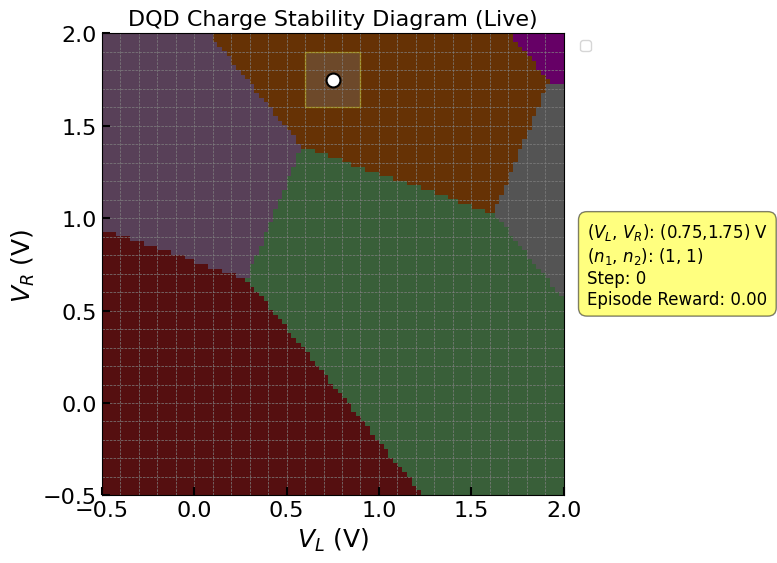

In [ ]:
obs, _ = test_env.reset(options={"get_CSD":True})

In [ ]:
visualize_and_generate_video_PPO(trained_net=trained_net_last_best, env=test_env, max_steps=300,
                                 expoleration=None, video_filename="steps_2o3M.mp4")

--- Starting visualization ---
DEBUG: 'get_CSD' is True. Loading pre-computed diagram...
DEBUG: Colormap colors: ['tab:red', 'plum', 'lightgreen', 'tab:orange']


--- Visualization complete. Total reward: 47.53 ---
--- Saving video to /content/drive/My Drive/Videos/20250717_PPO_LSTM/steps_2o3M_r_48.mp4 ---
--- Video saved successfully ---


In [ ]:
# prompt: open tensorboard

%load_ext tensorboard
%tensorboard --logdir "/content/drive/My Drive/TensorBoard/"


<IPython.core.display.Javascript object>